In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point
from shapely.ops import nearest_points
import matplotlib.patches as mpatches
import rasterio
from rasterio.transform import xy
import pandoc
import math
import plotly.express as px

pd.set_option('display.max_columns', None)

In [10]:
adm0 = gpd.read_file('data/geoborders/adm0/geoBoundaries-VNM-ADM0.geojson')

adm0_proj = adm0.to_crs(epsg=32648)

vietnam_area_km2 = adm0_proj.geometry.area.sum() / 1e6

vietnam_area_km2

331232.5226703409

In [11]:
level1 = pd.read_csv('analysis/data/level1-adm1-risk_with_context.csv')
level2 = pd.read_csv('analysis/data/level2-adm2-risk_with_context.csv')
level3 = pd.read_csv('analysis/data/level3-grid-risk_with_context.csv')

# Introduction
This project aims to analyze data related to the Vietnam War to answer the following questions:
1. What are the areas with high risk of UXO **land contamination** in Vietnam?
2. What would be the estimated clean up cost?
3. Where should we focus on cleaning up UXO?

There are different types of explosive remnants of war (ERW) like hand grenades, mines, etc. But in this notebook, we will only focus on ERW used in US Airforce missions, especially bombs.

> *Statistics of UXO contamination in Vietnam
> (05/01/20 21:07)*
>
> *Vietnam is one of the countries severely laden with war legacies. One of them is tens of thousands of tons of unexploded ordnance (UXO) scattering throughout the nation.*
>
> *The UXO remnants can be found in all localities of the whole country, be they the plain or mountainous areas. The remnants can also be found in forests or under water, etc.*
>
> *It is estimated that about 800,000 tons of UXO remain uncleared in all regions of Vietnam, covering the areas of nearly 6.1 million hectares contaminated and possibly contaminated with UXO, accounting for 18.71% of the country’s total area.*
>
> *All 63 out of 63 provinces and centrally-run cities are contaminated with UXO at different rates.*
>
> *According to the study conducted at 11,134 communes and wards of 63 provinces and centrally-run cities, as of December 2014, 9,116 communes and wards were found UXO-contaminated. Especially, there are localities with more than 80% of the area contaminated with UXO.*
>
> *Since 1975, UXO has killed more than 40,000 people and injured 60,000 others. Most of the victims were breadwinners in the families, ethnic minorities, and children.*
>
> *In some provinces in the Central region, UXO accidents have occurred to more than 22,800 people, leaving 10,540 dead and 12,260 injured.*
>
> *In five years, from 2013 to 2018, there were 1,813 cases caught in UXO accidents with nearly 1,000 deaths.*

*Source: https://vnmac.gov.vn/en/tin-tuc/statistics-of-uxo-contamination-in-vietnam.t-61.html*

# 1. Situation overview

In [12]:
print("Estimated UXO of every risk level")
level1.groupby('risk_level')['estimated_uxo'].sum().sort_values()

Estimated UXO of every risk level


risk_level
Low            3569.758
Elevated      41122.352
Moderate      50077.723
High         216251.912
Extreme      358002.483
Very High    748642.957
Name: estimated_uxo, dtype: float64

### At city level

In [13]:
level1.describe()

,estimated_uxo,weighted_risk_score,mission_density,population,area(km2),residence developed,residence,agricultural,open_terrain,shrubland,forest,wetlands_water
count,63.000000,63.000000,63.000000,6.300000e+01,63.000000,63.000000,63.000000,63.000000,63.000000,63.000000,63.000000,63.000000
mean,22502.653730,0.007140,77.573910,1.542617e+06,3726.984127,0.015018,0.021521,0.403686,0.024988,0.032277,0.416375,0.085493
std,40698.566713,0.010438,96.737314,1.493605e+06,3181.273652,0.028908,0.029638,0.290076,0.044473,0.069372,0.319673,0.140141
min,1.836000,0.000082,2.466667,3.265040e+05,110.000000,0.000000,0.000422,0.031092,0.000000,0.000000,0.000000,0.000632
25%,1534.062000,0.001128,13.512101,8.832070e+05,1460.000000,0.000314,0.002740,0.144096,0.003282,0.000000,0.029038,0.020081
50%,7743.114000,0.003166,41.388451,1.248111e+06,2630.000000,0.002007,0.015055,0.311423,0.011598,0.000000,0.491577,0.036233
75%,23930.269500,0.008921,99.023276,1.607072e+06,5195.000000,0.015499,0.026815,0.661653,0.024717,0.013439,0.667763,0.067662
max,243338.344000,0.065344,556.578512,9.456661e+06,16150.000000,0.139461,0.186033,0.968290,0.239781,0.297727,0.953180,0.786111


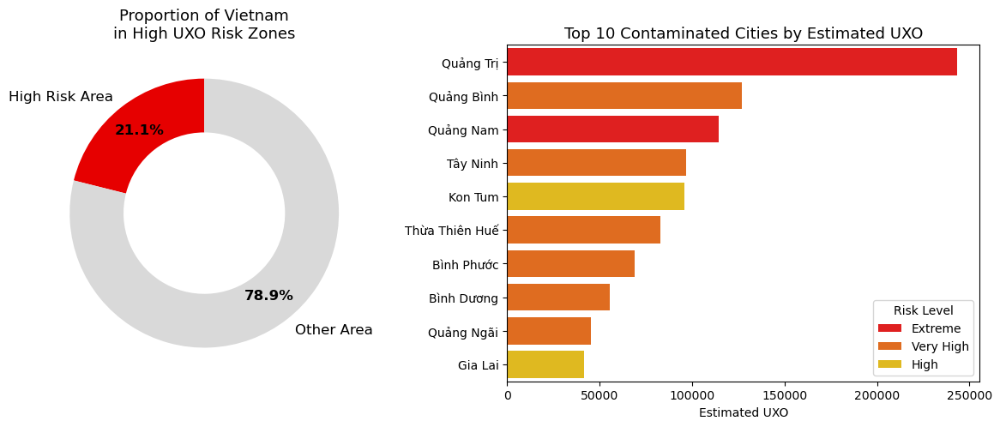

In [14]:
top_cities = (
    level1.sort_values("estimated_uxo", ascending=False)
    .head(10)[["city", "estimated_uxo", "risk_level"]]
    .rename(columns={"city": "Province"})
)

risk_palette = {
    'Extreme': '#FF0000',   # Bright saturated red
    'Very High': '#FF6600', # Vivid orange
    'High': '#FFCC00',      # Yellow-orange
    'Elevated': '#FFFF00',  # Bright yellow
    'Moderate': '#99CC00',  # Yellow-green
    'Low': '#009900'        # Strong green
}

# Filter high-risk areas
high_risk_levels = ['Extreme', 'Ver High', 'High']
high_risk_area = level1[level1['risk_level'].isin(high_risk_levels)]['area(km2)'].sum()

# Compute total Vietnam area (from previous step)
# vietnam_area_km2 = <computed from adm0 above>
other_area = vietnam_area_km2 - high_risk_area

# Values and labels
values = [high_risk_area, other_area]
labels = ['High Risk Area', 'Other Area']
colors = ['#ff6666', '#cccccc']


fig, axes = plt.subplots(1, 2, figsize=(12, 5), gridspec_kw={'width_ratios': [1, 1.3]})

wedges, texts, autotexts = axes[0].pie(
    [high_risk_area, other_area],
    labels=['High Risk Area', 'Other Area'],
    autopct='%1.1f%%',
    startangle=90,
    colors=['#e60000', '#d9d9d9'],
    wedgeprops=dict(width=0.4),
    pctdistance=0.78,
    labeldistance=1.1,
    textprops={'fontsize': 12, 'color': 'black'}
)
for autotext in autotexts:
    autotext.set_color('black')
    autotext.set_fontsize(12)
    autotext.set_weight('bold')
axes[0].set_title("Proportion of Vietnam\nin High UXO Risk Zones", fontsize=13)

sns.barplot(
    data=top_cities,
    y="Province",
    x="estimated_uxo",
    hue="risk_level",
    dodge=False,
    palette=risk_palette,
    ax=axes[1]
)
axes[1].set_title("Top 10 Contaminated Cities by Estimated UXO", fontsize=13)
axes[1].set_xlabel("Estimated UXO")
axes[1].set_ylabel("")
axes[1].legend(title="Risk Level", loc="lower right")

plt.tight_layout()
plt.show()


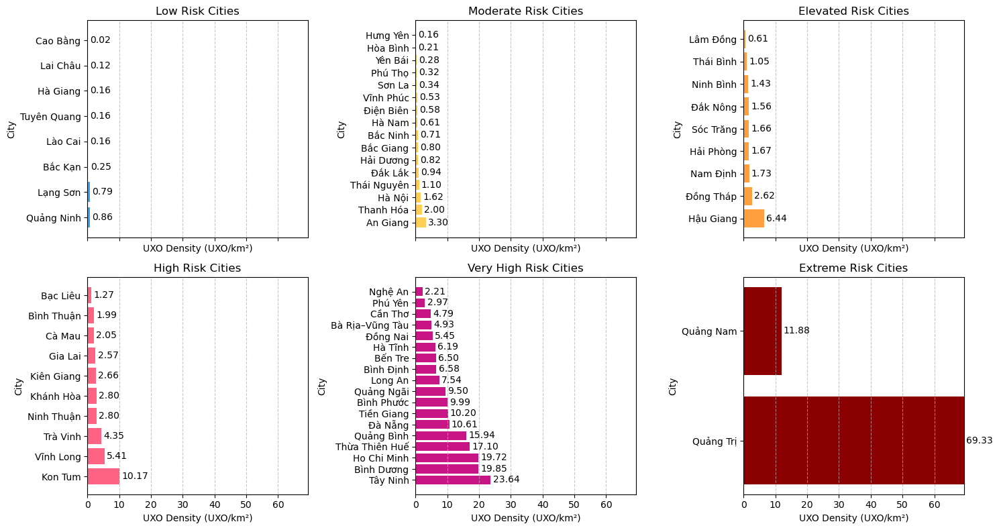

In [15]:
import matplotlib.pyplot as plt

# Define risk levels in order
risk_levels = ['Low', 'Moderate', 'Elevated', 'High', 'Very High', 'Extreme']

# Add a new column for UXO density
level1['uxo_density'] = level1['estimated_uxo'] / level1['area(km2)']

# Create a 2x3 subplot grid
fig, axes = plt.subplots(2, 3, figsize=(15, 8), sharex=True)
axes = axes.flatten()

# Color for each risk level
colors = ['#36A2EB', '#FFCE56', '#FF9F40', '#FF6384', '#C71585', '#8B0000']

# Find max density for consistent x-axis
max_density = level1['uxo_density'].max()

for i, risk in enumerate(risk_levels):
    # Filter and sort data for current risk level by density descending
    df_subset = level1[level1['risk_level'] == risk].copy()
    df_subset = df_subset.sort_values('uxo_density', ascending=False)
    
    cities = df_subset['city']
    densities = df_subset['uxo_density']
    
    # Bar plot
    axes[i].barh(cities, densities, color=colors[i])
    axes[i].set_title(f'{risk} Risk Cities')
    axes[i].set_xlabel('UXO Density (UXO/km²)')
    axes[i].set_ylabel('City')
    axes[i].grid(True, axis='x', linestyle='--', alpha=0.7)
    axes[i].set_xlim(0, max_density)
    
    # Annotate values
    for j, (density, city) in enumerate(zip(densities, cities)):
        axes[i].text(density + max_density * 0.01, j, f'{density:.2f}', va='center')

# Adjust layout
plt.tight_layout()
plt.show()


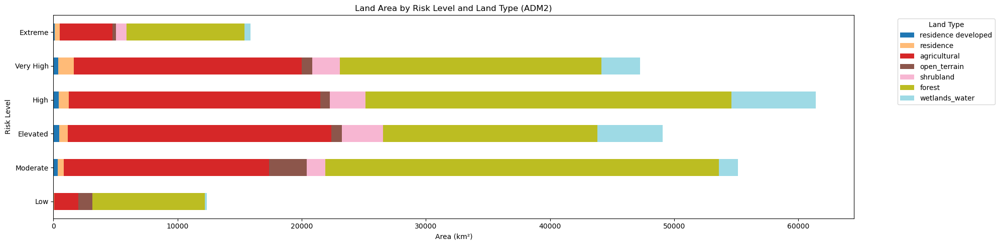

In [16]:
land_types = ['residence developed', 'residence', 'agricultural', 'open_terrain', 'shrubland', 'forest', 'wetlands_water']
risk_levels = level2['adm2_risk'].unique()

area_by_risk_land = pd.DataFrame(index=risk_levels, columns=land_types, dtype=float).fillna(0)

for risk in risk_levels:
    df_risk = level2[level2['adm2_risk'] == risk]
    area_sum = (df_risk[land_types].multiply(df_risk['area(km2)'], axis=0)).sum()
    area_by_risk_land.loc[risk] = area_sum

risk_order = ['Low', 'Moderate', 'Elevated', 'High', 'Very High', 'Extreme']
area_by_risk_land = area_by_risk_land.reindex(risk_order)

ax = area_by_risk_land.plot(kind='barh', stacked=True, figsize=(20,5), colormap='tab20')

plt.title('Land Area by Risk Level and Land Type (ADM2)')
plt.xlabel('Area (km²)')
plt.ylabel('Risk Level')
plt.legend(title='Land Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


### At district level

In [17]:
level2.describe()

,grid_count,estimated_uxo,weighted_risk_score,average_risk_score,mission_density,weapons_density,weighted_avg_risk_level,area(km2),residence developed,residence,agricultural,open_terrain,shrubland,forest,wetlands_water
count,676.000000,676.000000,676.000000,676.000000,676.000000,6.760000e+02,676.000000,676.000000,676.000000,676.000000,676.000000,676.000000,676.000000,676.000000,676.000000
mean,35.689349,2105.134593,125.286982,0.007710,3170.042899,3.445161e+04,3.303862,356.893491,0.038234,0.040566,0.431131,0.024216,0.031443,0.345081,0.084628
std,35.849537,5712.162487,148.469427,0.014931,6810.014560,8.909710e+04,1.447524,358.495367,0.120505,0.091039,0.323582,0.052646,0.078070,0.340771,0.163218
min,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000e+00,1.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,10.000000,59.861250,26.750000,0.000580,167.000000,1.046000e+03,2.000000,100.000000,0.000000,0.001073,0.119518,0.000476,0.000000,0.003432,0.006189
50%,24.000000,353.803500,72.000000,0.002595,707.500000,6.313000e+03,3.211310,240.000000,0.000658,0.009731,0.397089,0.004172,0.000000,0.267024,0.026406
75%,48.000000,1639.529750,168.750000,0.008674,3454.500000,2.970250e+04,4.537202,480.000000,0.015876,0.033059,0.740028,0.018842,0.005590,0.655923,0.082957
max,241.000000,71696.979000,1292.000000,0.210666,66440.000000,1.104959e+06,6.000000,2410.000000,0.946108,0.775625,0.989365,0.450977,0.441202,0.992823,1.000000


In [36]:
import pandas as pd
import plotly.express as px

adm1_risk = level2_cleaned.groupby('ADM1_name')['weighted_avg_risk_level'].mean().reset_index()

# Define a function to convert weighted risk scores to categories
def risk_category(score):
    if score >= 5:
        return 'Extreme'
    elif score >= 4:
        return 'Very High'
    elif score >= 3:
        return 'High'
    elif score >= 2:
        return 'Elevated'
    elif score >= 1:
        return 'Moderate'
    else:
        return 'Low'

adm1_risk['adm1_risk'] = adm1_risk['weighted_avg_risk_level'].apply(risk_category)

adm1_risk_dict = dict(zip(adm1_risk['ADM1_name'], adm1_risk['adm1_risk']))

level2_cleaned['adm1_risk'] = level2_cleaned['ADM1_name'].map(adm1_risk_dict)

level2_cleaned['display_name'] = level2_cleaned['ADM2_name'] + ' (' + level2_cleaned['ADM1_name'] + ')'

# Define color map
color_map = {
    'Extreme': '#8B0000',
    'Very High': '#FF4500',
    'High': '#FFA500',
    'Elevated': '#FF8C00',
    'Moderate': '#FFD700',
    'Low': '#9ACD32'
}

# Create the treemap with the correct hierarchical coloring
fig = px.treemap(
    level2_cleaned,
    path=['ADM1_name', 'display_name'],  # Use display_name to avoid duplicate issues
    values='weighted_avg_risk_level',
    color='adm2_risk',  # Use ADM2 risk for coloring
    color_discrete_map=color_map,
    custom_data=['adm1_risk', 'adm2_risk', 'weighted_avg_risk_level']  # Store both risk levels
)

# Update the treemap to color ADM1 boxes with their risk level
fig.update_traces(
    marker=dict(
        colors=[color_map[risk] for risk in level2_cleaned['adm2_risk']],
        line=dict(width=1)
    ),
    hovertemplate='<b>%{label}</b><br>Risk Level: %{customdata[1]}<br>Score: %{customdata[2]:.2f}<extra></extra>'
)

# Update layout
fig.update_layout(
    margin=dict(t=50, l=10, r=10, b=10),
    title='Treemap of Risk Level by Province and District'
)

fig.show()

In [173]:
fig = px.treemap(
    level2_cleaned,
    path=['ADM1_name', 'ADM2_name'],
    values='average_risk_score',
    color='adm2_risk',
    color_discrete_map=color_map,
    title='Treemap of Weighted Risk Score by Province and District (By Average Risk Score of 10km2 patches)'
)
fig.update_layout(margin=dict(t=50, l=10, r=10, b=10))
fig.show()


In [201]:
fig = px.strip(
    level2_cleaned,
    x='ADM1_name',
    y='weighted_avg_risk_level',
    color='adm2_risk',
    color_discrete_map=color_map,
    title='ADM2 Weighted Risk Scores Grouped by Province',
)
fig.update_layout(xaxis_tickangle=90, height=600)
fig.show()


# 2. Current state of UXO clearance
Specific data regarding the locations and clearance of UXO (Unexploded Ordnance) areas are highly sensitive and remain classified, thus not publicly available. However, some generalized statistics have been published, which we can use as a basis to estimate our own figures. These include factors such as the cost of UXO clearance, the typical speed of clearance operations, and practical parameter values necessary for constructing our model.

#### Quang Tri Mine Action Center data

Source: https://www.qtmac.vn/en/facts-and-figures/clearance \
Quang Tri Province
Area: 4,747 km2 (474,700 ha)\
Population: 600.7 thousand people (2001)\
City: Dong Ha\
Ethnicitíe: Kinh, Bru-Van Kieu, Hoa, Ta Oi.\
Administrative Division:

Town: Quang Tri\
Districts: Cam Lo, Con Co, Dakrong, Hai Lang, Huong Hoa, Gio Linh, Trieu Phong, Vinh Linh.

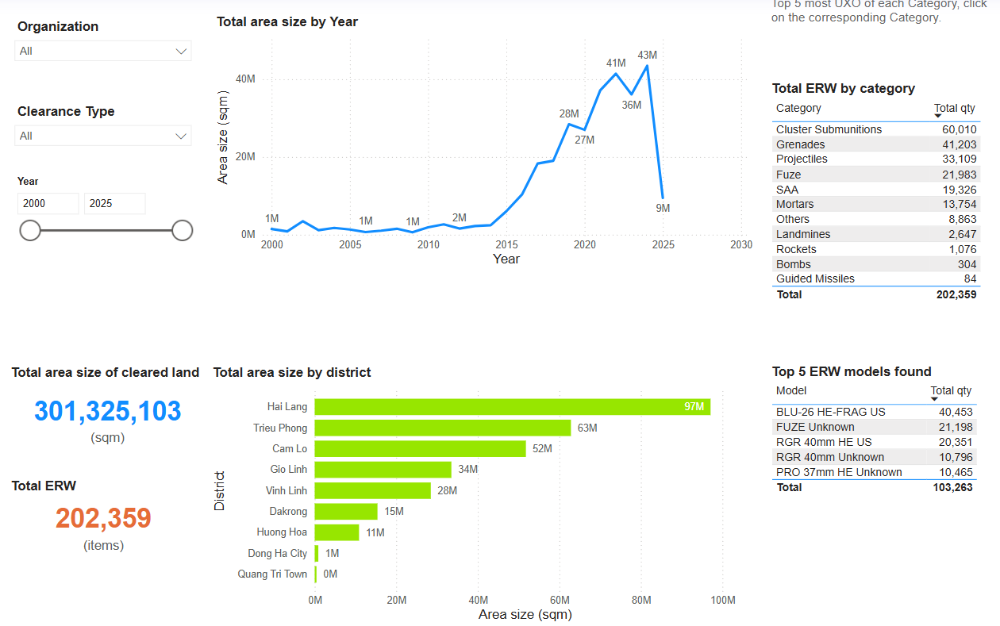

301,325,103 sqm ~ 301 sqkm is the total area cleared in Quang Tri since 2000 which is approximately 12 sqkm per year. Although this might sound like a humble number but to put into perspective, 12 sqkm is the area of Cầu Giấy district.\
The percentage of land cleared in Quang Tri is 0.063%. 

As of 2025, over \\$110 million has been mobilized for unexploded ordnance (UXO) clearance in Quang Tri Province, Vietnam, since 1995. This includes contributions from the Vietnamese government, international donors, and non-governmental organizations (NGOs). For instance, PeaceTrees Vietnam has committed over \$26.3 million to the province, focusing on bomb and mine clearance, victim support, and socio-economic development initiatives .([Vietnam+ (VietnamPlus)][1])

In the 2010–2020 period alone, Vietnam spent a total of 12.6 trillion VND (approximately \\$545 million) on bomb and mine detection and clearance, with 2.2 trillion VND (about \$95 million) coming from non-refundable aid .([Vietnam+ (VietnamPlus)][1])

These efforts have led to the clearance of over 25,000 hectares of land and the safe removal of more than 765,000 UXO items in Quang Tri Province .([Vietnam+ (VietnamPlus)][2])

While the exact total amount spent on demining activities in Quang Tri from 2000 to 2025 is not specified, the combined contributions from various sources have significantly advanced the province's efforts to address the legacy of war-related contamination.

[1]: https://en.vietnamplus.vn/545-mln-usd-spent-on-bomb-and-mine-detection-clearance-over-last-decade-post194465.vnp?utm_source=chatgpt.com "545 mln USD spent on bomb and mine detection, clearance over last decade | Vietnam+ (VietnamPlus)"
[2]: https://en.vietnamplus.vn/quang-tri-over-25000-ha-of-land-cleared-from-war-left-uxos-post222488.vnp?utm_source=chatgpt.com "Quang Tri: Over 25,000 ha of land cleared from war-left UXOs | Vietnam+ (VietnamPlus)"

**So approximately \\$4.4 million is spent to clear 12sqkm of land per year, which is about \\$3.6 million per 10sqkm, I will round it down to \\$3 million for minimum cost estimation, and the reasonable speed for the whole Quảng Trị city (which is administrative level 1) is 10sqkm per year.**

**Comparing to our statistics for the number of 10km squares marked with High to Extreme risk:**

In [175]:
qt_model_data = level3[level3['ADM1_name'] == 'Quảng Trị']

area_by_risk_level = qt_model_data.groupby('risk_level').size().sort_values(ascending=False)

print(area_by_risk_level)

risk_level
Extreme      435
Very High     44
High           5
dtype: int64


In [77]:
qtmac = pd.read_csv('data/qtmac_data.csv')

In [78]:
qtmac['weapon_class'].unique()

array(['cluster bomb', 'bomb and carpet bomb', 'mortar', 'rocket',
       'firearm munition', 'artillery shell', 'grenade', 'mine', 'fuze'],
      dtype=object)

#### Strategy in demining activity

From left to right:
1. 10km2 Risk score caluclated based on ...
2. Weighted average risk score of ADM2
3. Actual clearance data

<table>
<tr>
<td>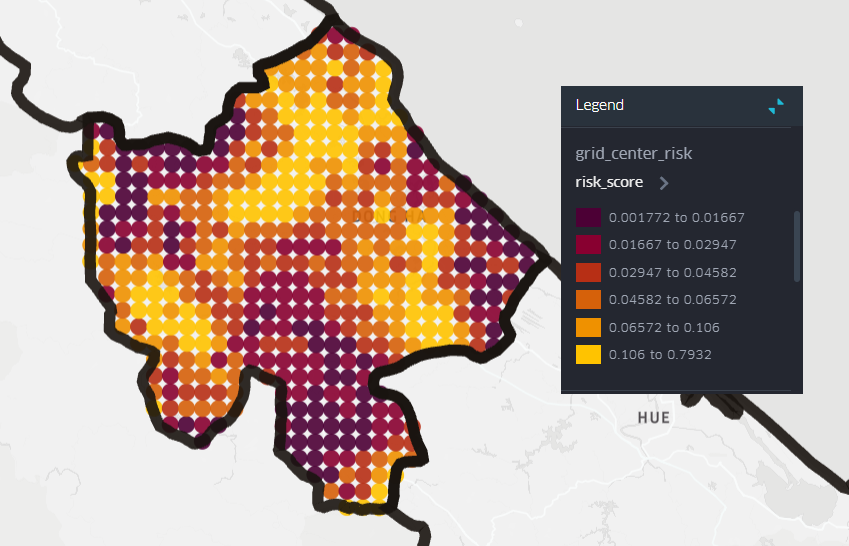</td>
<td>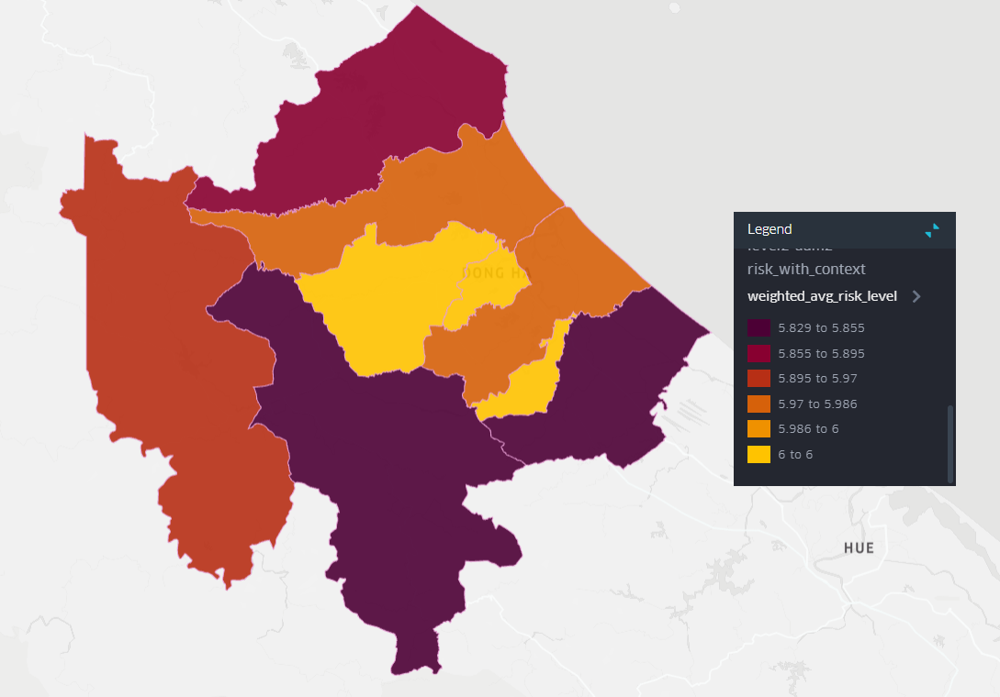</td>
<td>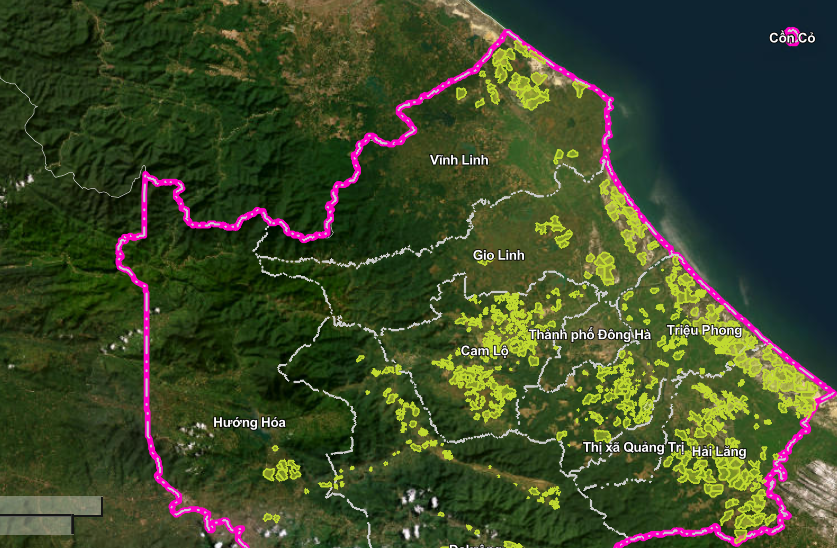</td>
<td>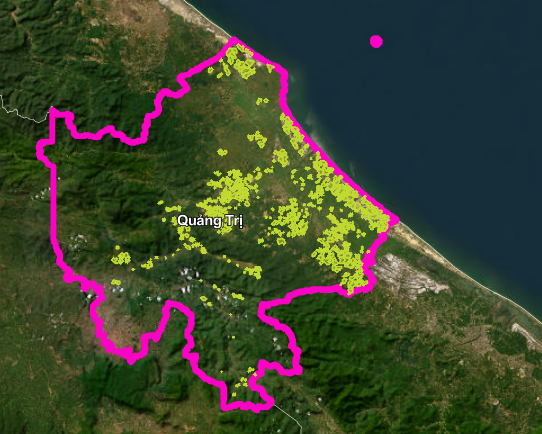</td>
</tr>
</table>

<table>
<tr>
<td>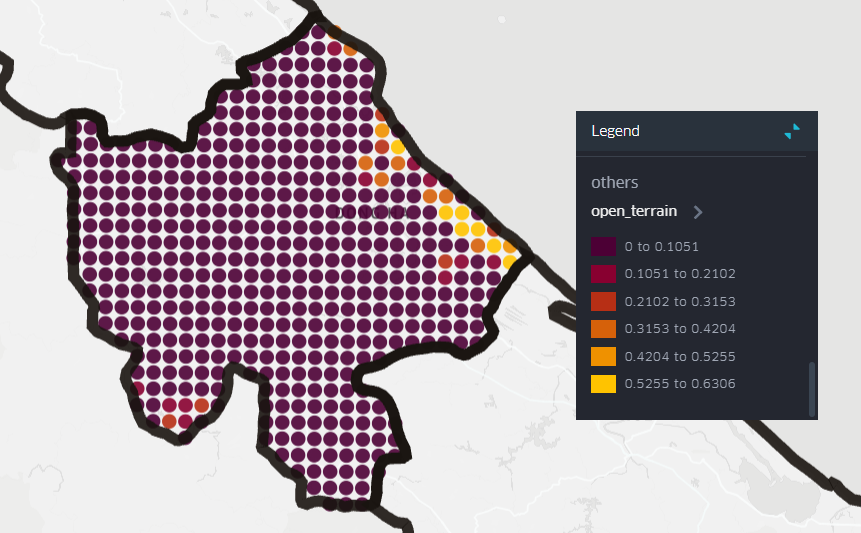</td>
<td>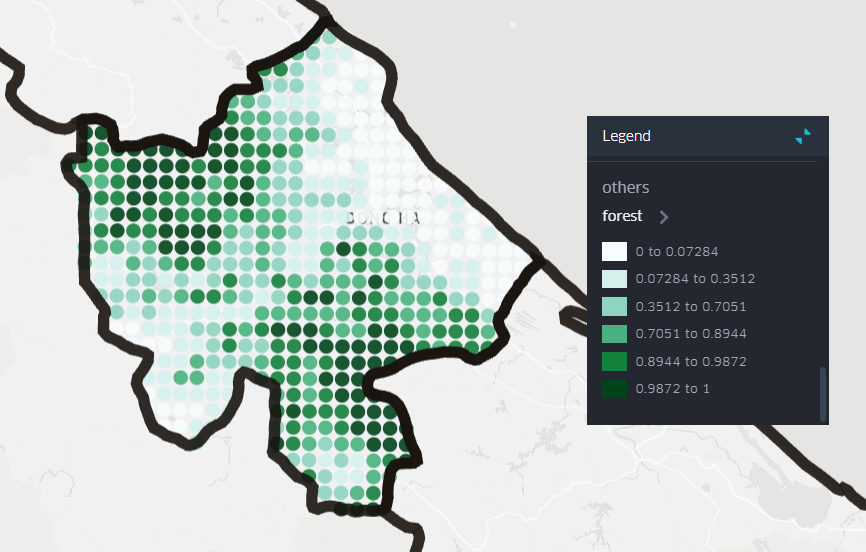</td>
<td>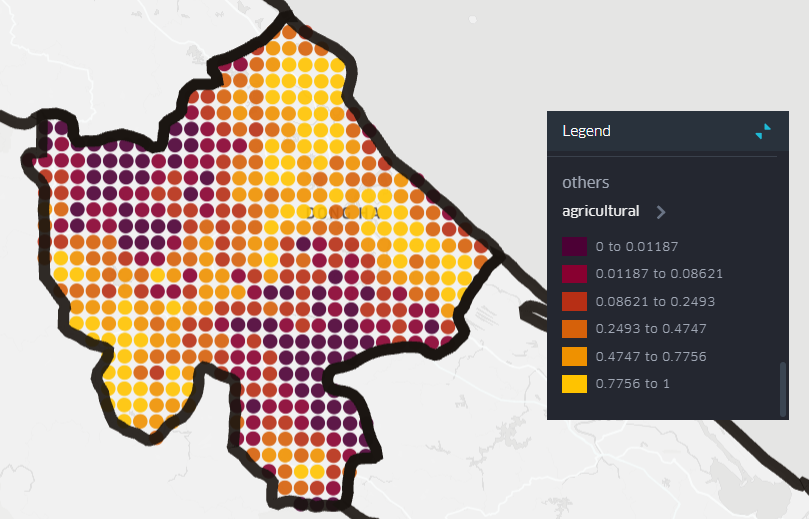</td>
<td>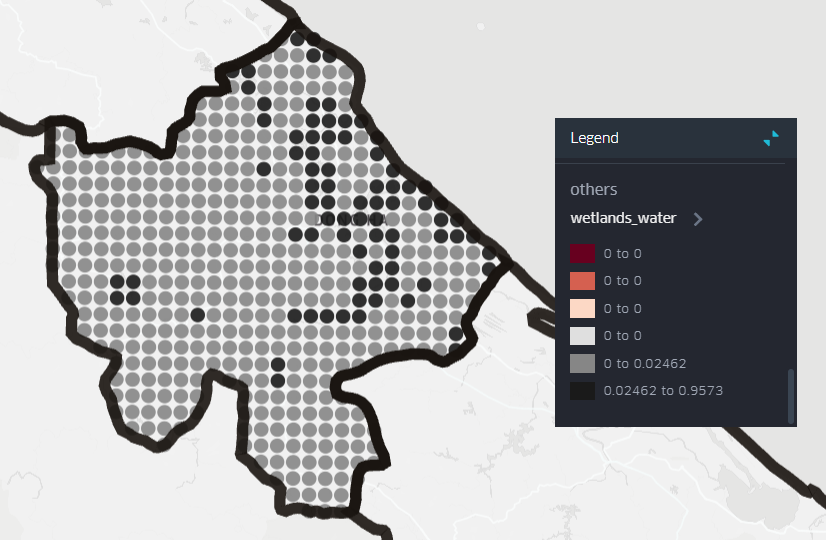</td>
</tr>
</table>

Demining activities are carried out among residence areas that are not as developed as urban areas, and not carried out at inhabitted areas like mountains.

<div style="display: flex; justify-content: space-between;">
  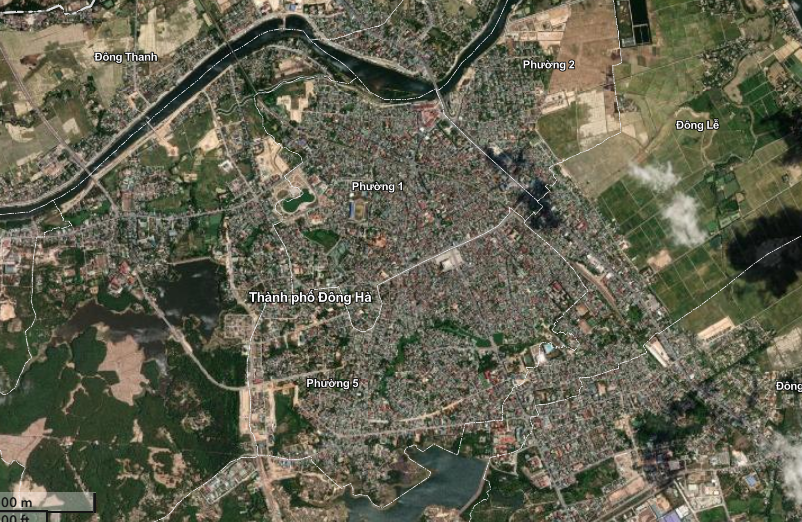
  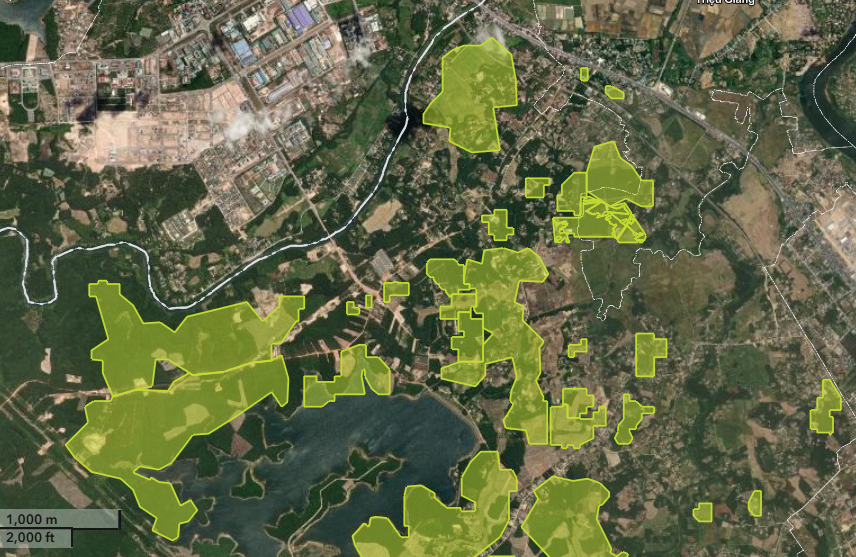
  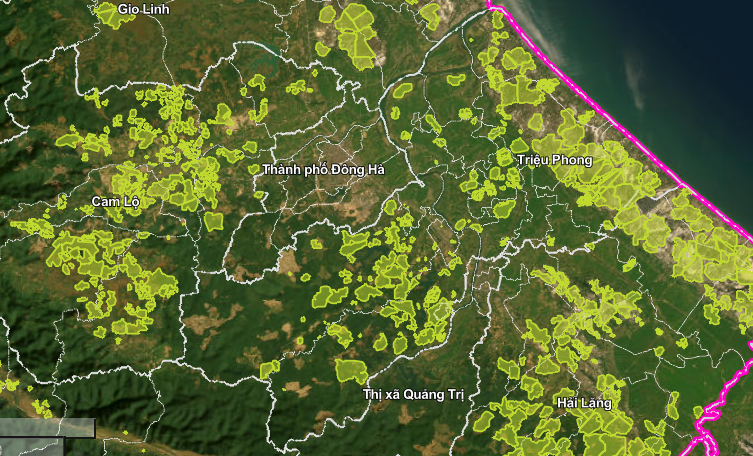
</div>

#### VNMAC Infographic

<table>
<tr>
  <td>
    <figure>
      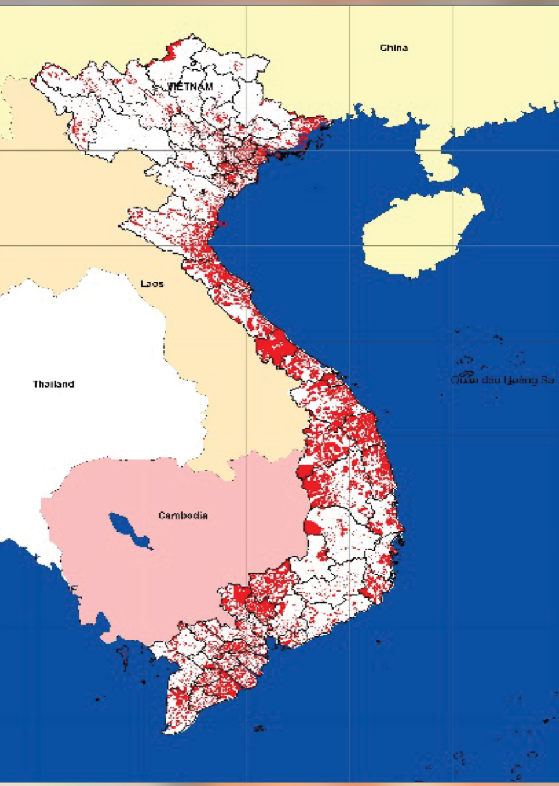
      <figcaption style="text-align: center;">VNMAC data</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      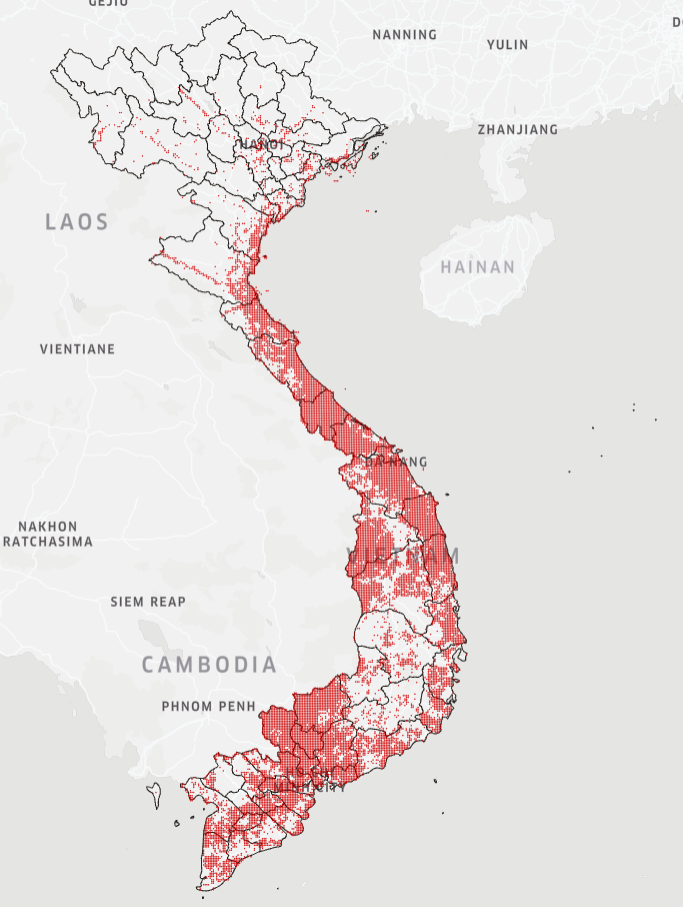
      <figcaption style="text-align: center;">Estimated High, Very High, Extreme</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      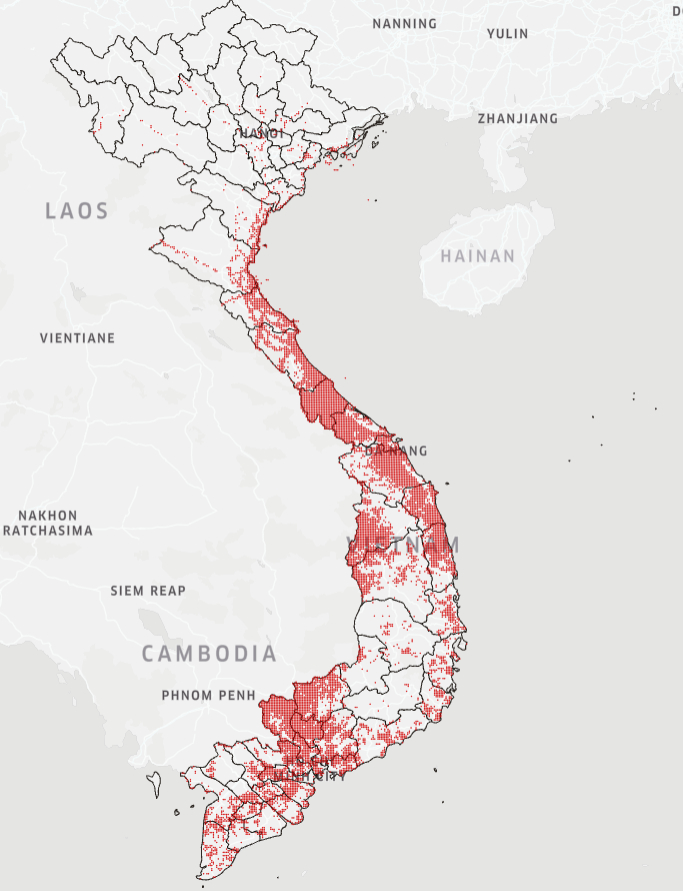
      <figcaption style="text-align: center;">Estimated Very High, Extreme</figcaption>
    </figure>
  </td>
</tr>
</table>

In the VNMAC UXO contamination map, there are traces of unexploded ordnance (UXO) along the northeastern border of Vietnam, particularly in Hà Giang, Lào Cai, and parts of the far western border. This contrasts with our dataset, which only contains records of U.S. bombing missions. The broader coverage in VNMAC’s data reflects UXO contamination from multiple historical periods, not just the Vietnam War.

The UXO presence along the northern border can largely be attributed to the 1979 Sino-Vietnamese Border War, during which heavy artillery and ground combat took place. In the far west, especially near Điện Biên Phủ, UXOs are remnants from the First Indochina War, when French forces engaged in major military operations against the Việt Minh.

Additionally, some UXO contamination in these regions may come from old munitions depots, transit routes, or abandoned weapon caches left behind by different armies over time. These aging munitions, even if never deployed in combat, can degrade and become hazardous, contributing to UXO risks seen today.

In [176]:
import pandas as pd

risk_groups = {
    'Moderate to Extreme': ['Moderate', 'High', 'Very High', 'Extreme'],
    'High to Extreme': ['High', 'Very High', 'Extreme'],
    'Very High to Extreme': ['Very High', 'Extreme'],
    'Extreme': ['Extreme']
}
# Your existing data dict
areas_dict = {'VNMAC': [61000]}
for label, risks in risk_groups.items():
    area_sum = level2[level2['adm2_risk'].isin(risks)]['area(km2)'].sum()
    areas_dict[label] = [area_sum]

# Convert dict to DataFrame with 1 row
areas = pd.DataFrame(areas_dict)

# Add VNMAC as a 'VNMAC' group row for consistency
areas_long = areas.melt(var_name='Risk Group', value_name='Area (km2)')

# Replace 'VNMAC' label to something consistent
areas_long.loc[areas_long['Risk Group'] == 'VNMAC', 'Risk Group'] = 'VNMAC area covered'

# Set Risk Group as index
areas_long = areas_long.set_index('Risk Group')

areas_long

,Area (km2)
Risk Group,
VNMAC area covered,61000
Moderate to Extreme,179700
High to Extreme,124570
Very High to Extreme,63150
Extreme,15870


The statistic published by VNMAC is of the amount of UXO found, the area covered closely matches 'Very High' to 'Extreme' group and so does the graph, it is possible that these areas have been taken care of by VNMAC.

#### Rough estimation of cost based on assumption

Vietnam's annual budget for unexploded ordnance (UXO) clearance varies based on government allocations and international assistance.

> *Historically, the Vietnamese government has allocated approximately \$30 million per year for UXO clearance efforts.*

Additionally, international partners, including the United States, have provided substantial funding.

> *Since 1993, the U.S. has invested over \$234 million in Vietnam for UXO clearance, dioxin remediation, and support for people with disabilities.*
> (\[Every CRS Report]\[1], \[VnExpress Intl.]\[2])

For instance,

> *During the 2010–2020 period, Vietnam cleared nearly 50,000 hectares of land at a total cost exceeding VND 12.6 trillion (approximately \$540 million), with over VND 10.4 trillion sourced from Vietnam's budget and the remainder from international aid.*
> (\[VnExpress Intl.]\[3])

Looking ahead,

> *The government has set an ambitious target to clear 500,000 hectares by 2025, aiming to clean approximately 75,000 hectares annually.*
> (\[VnExpress Intl.]\[3])

These figures underscore the substantial financial commitment required to address the legacy of UXO contamination in Vietnam.

\[1]: [https://www.everycrsreport.com/reports/R45749.html](https://www.everycrsreport.com/reports/R45749.html) "War Legacy Issues in Southeast Asia: Unexploded Ordnance (UXO)"\
\[2]: [https://e.vnexpress.net/news/news/environment/vietnam-us-launch-700-000-uxo-disposal-training-range-4881672.html](https://e.vnexpress.net/news/news/environment/vietnam-us-launch-700-000-uxo-disposal-training-range-4881672.html) "Vietnam, US launch \$700000 UXO disposal training range"\
\[3]: [https://e.vnexpress.net/news/news/vietnam-to-speed-up-demining-process-4429124.html](https://e.vnexpress.net/news/news/vietnam-to-speed-up-demining-process-4429124.html) "Vietnam to speed up demining process - VnExpress International"

#### Parameters
Cleanup cost: $3,000,000/10Km2 \
Annual goal: 500,000 hectares = 5000km2 \
Annual budget: \\$540,000,000 / 10 = \\$54,000,000 per year

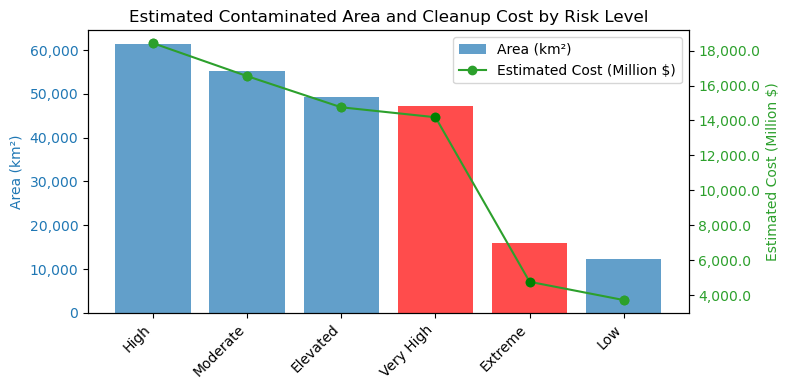

In [177]:
from matplotlib.ticker import FuncFormatter

area_by_risk = level2.groupby('adm2_risk')['area(km2)'].sum().sort_values(ascending=False)
cost_per_km2 = 300_000  # $300,000 per km²
cost_by_risk = area_by_risk * cost_per_km2

def comma_formatter(x, pos):
    return f'{int(x):,}'

highlight_risks = {'Extreme', 'Very High'}
bar_colors = ['red' if risk in highlight_risks else 'tab:blue' for risk in area_by_risk.index]
line_colors = ['red' if risk in highlight_risks else 'tab:green' for risk in cost_by_risk.index]

fig, ax1 = plt.subplots(figsize=(8, 4))

# Bar chart
bars = ax1.bar(area_by_risk.index, area_by_risk.values, color=bar_colors, alpha=0.7, label='Area (km²)')
ax1.set_ylabel('Area (km²)', color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')
ax1.set_xticks(range(len(area_by_risk.index)))
ax1.set_xticklabels(area_by_risk.index, rotation=45, ha='right')
ax1.yaxis.set_major_formatter(FuncFormatter(comma_formatter))

# Line plot
ax2 = ax1.twinx()
line_plot, = ax2.plot(range(len(cost_by_risk.index)), cost_by_risk.values / 1e6,
                      color='tab:green', marker='o', linestyle='-', label='Estimated Cost (Million $)')

for i, (x, y) in enumerate(zip(cost_by_risk.index, cost_by_risk.values / 1e6)):
    ax2.plot(i, y, 'o', color='green' if x in highlight_risks else 'tab:green')

ax2.set_ylabel('Estimated Cost (Million $)', color='tab:green')
ax2.tick_params(axis='y', labelcolor='tab:green')
ax2.yaxis.set_major_formatter(FuncFormatter(lambda x, pos: f'{x:,.1f}'))
ax1.grid(False)
ax2.grid(False)

handles1, labels1 = ax1.get_legend_handles_labels()
handles2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(handles1 + [line_plot], labels1 + [line_plot.get_label()], loc='upper right')

plt.title('Estimated Contaminated Area and Cleanup Cost by Risk Level')
fig.tight_layout()
plt.show()


The chart shows that prioritizing cleanup in areas classified as *Very High* and *Extreme* risk is both feasible within a limited budget and critical due to their urgency.


# 3. Building a clean up strategy

## Objective
It is unrealistic to cleanup every single UXO in Vietnam due to manpower and budget problem, therefore, we have to devise a strategy for cleaning up by prioirty.
Suppose that we are given a fixed annual budget used for demining what would be the strategy for 10 years?

Method: Classify the data into N number of years with descending severity.

Problem:
- Given the cost of demining 10km2 'm'
- What would be the demining stratgy with maximum efficiency for 10 years?

#### We will be using Level 2 data as it contains both information of level 1 and 3
- We are going to optimize using weighted features, the current features are extracted from visual analysis from the demining pattern in Quang Tri since we don't have actual data.
- The weight reflect possibility and need of clearance of an area.
- For example, wetland, forest and shrubland areas are less subjected to clearance as they are harder and possibly cost more. Whereas agricultural, open terrains are demined more.
- Since we don't have data on cleared areas, we can create priority model, and the cleared areas are possibly within the prioritized ares in our model.

#### Parameters
Cleanup cost: $3,000,000 per 10Km2 \
Annual budget: \\$540,000,000 / 10 = \\$54,000,000 per year

#### Scenario 1: Supposing Extreme and Very High risk area has been cleared

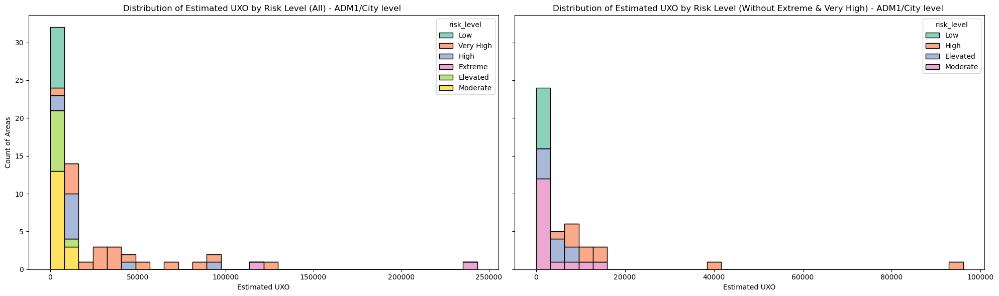

In [178]:
fig, axes = plt.subplots(1, 2, figsize=(20, 6), sharey=True)

sns.histplot(
    data=level1,
    x='estimated_uxo',
    hue='risk_level',
    bins=30,
    multiple='stack',
    palette='Set2',
    ax=axes[0]
)

axes[0].set_title('Distribution of Estimated UXO by Risk Level (All) - ADM1/City level ')
axes[0].set_xlabel('Estimated UXO')
axes[0].set_ylabel('Count of Areas')

filtered_level1 = level1[~level1['risk_level'].isin(['Extreme', 'Very High'])]

sns.histplot(
    data=filtered_level1,
    x='estimated_uxo',
    hue='risk_level',
    bins=30,
    multiple='stack',
    palette='Set2',
    ax=axes[1]
)
axes[1].set_title('Distribution of Estimated UXO by Risk Level (Without Extreme & Very High) - ADM1/City level ')
axes[1].set_xlabel('Estimated UXO')
axes[1].set_ylabel('')

plt.tight_layout()
plt.show()


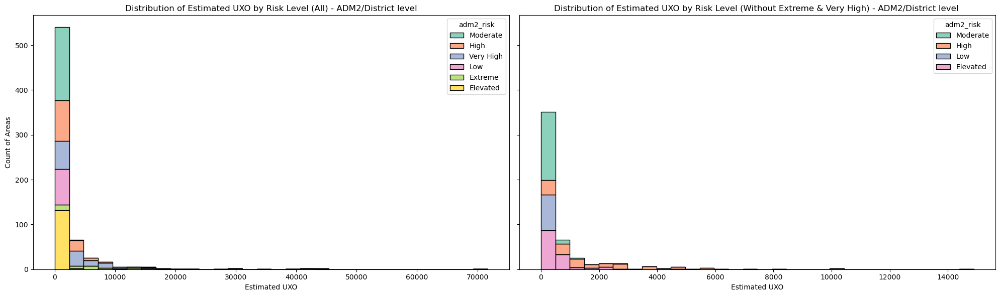

In [179]:
fig, axes = plt.subplots(1, 2, figsize=(20, 6), sharey=True)

sns.histplot(
    data=level2,
    x='estimated_uxo',
    hue='adm2_risk',
    bins=30,
    multiple='stack',
    palette='Set2',
    ax=axes[0]
)

axes[0].set_title('Distribution of Estimated UXO by Risk Level (All) - ADM2/District level')
axes[0].set_xlabel('Estimated UXO')
axes[0].set_ylabel('Count of Areas')

filtered_level2 = level2[~level2['adm2_risk'].isin(['Extreme', 'Very High'])]

sns.histplot(
    data=filtered_level2,
    x='estimated_uxo',
    hue='adm2_risk',
    bins=30,
    multiple='stack',
    palette='Set2',
    ax=axes[1]
)
axes[1].set_title('Distribution of Estimated UXO by Risk Level (Without Extreme & Very High) - ADM2/District level ')
axes[1].set_xlabel('Estimated UXO')
axes[1].set_ylabel('')

plt.tight_layout()
plt.show()


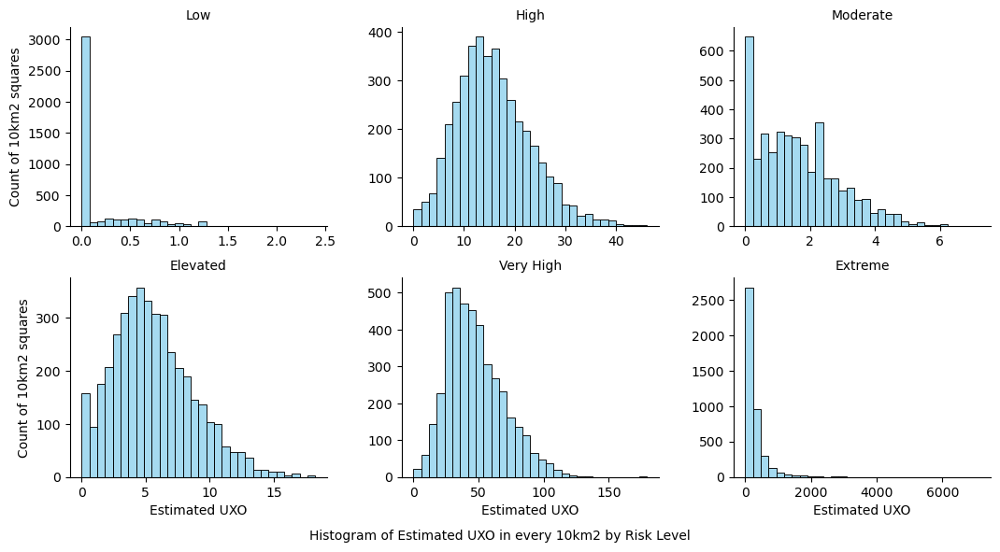

In [180]:
g = sns.FacetGrid(level3, col='risk_level', col_wrap=3, height=3, aspect=1.2, sharex=False, sharey=False)
g.map_dataframe(sns.histplot, x='est_dud_weapon', bins=30, color='skyblue')

g.set_titles('{col_name}')
g.set_axis_labels('Estimated UXO', 'Count of 10km2 squares')

g.fig.subplots_adjust(top=0.9)
g.fig.text(0.5, -0.02, 'Histogram of Estimated UXO in every 10km2 by Risk Level', ha='center', va='bottom', wrap=True)
plt.show()

### Inspecting Risk Levels of 10km2 grid ans ADM2

<table>
  <tr>
    <td>
      <figure>
        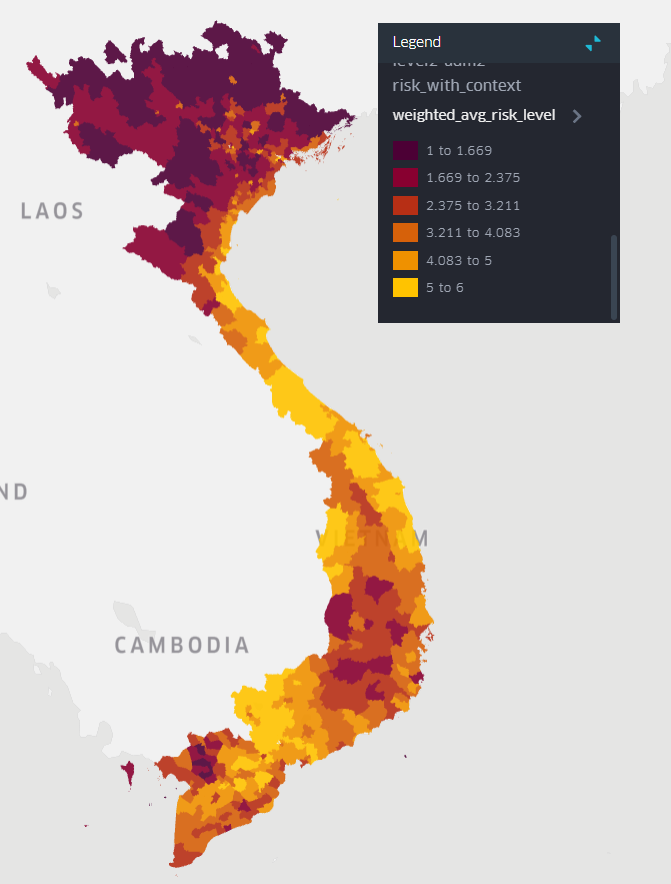
        <figcaption style="text-align: center;">ADM2 Risk Levels</figcaption>
      </figure>
    </td>
    <td>
      <figure>
        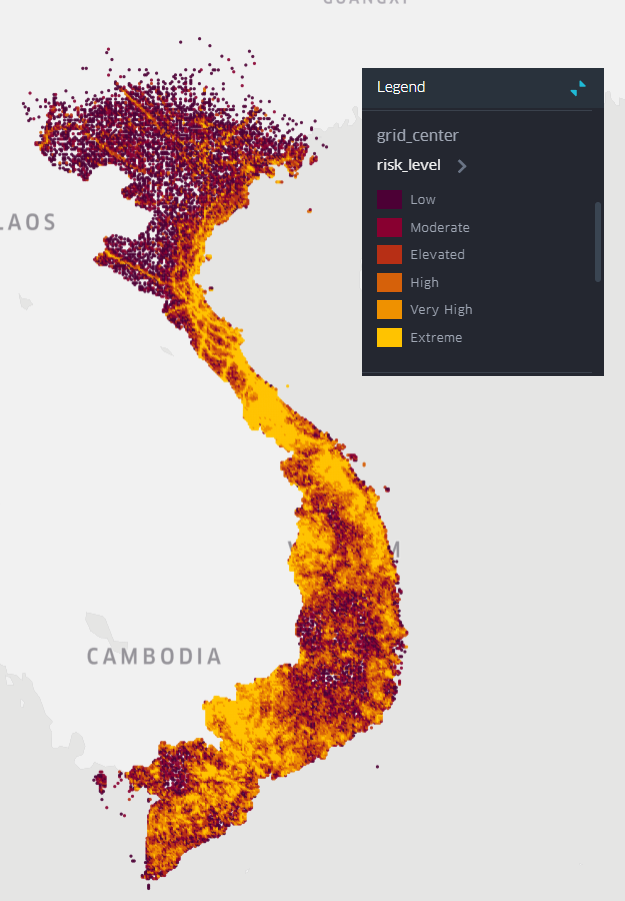
        <figcaption style="text-align: center;">10km2 Square Risk Levels</figcaption>
      </figure>
    </td>
  </tr>
</table>


### UXO count by different grid level

<table>
<tr>
    <td>
    <figure>
      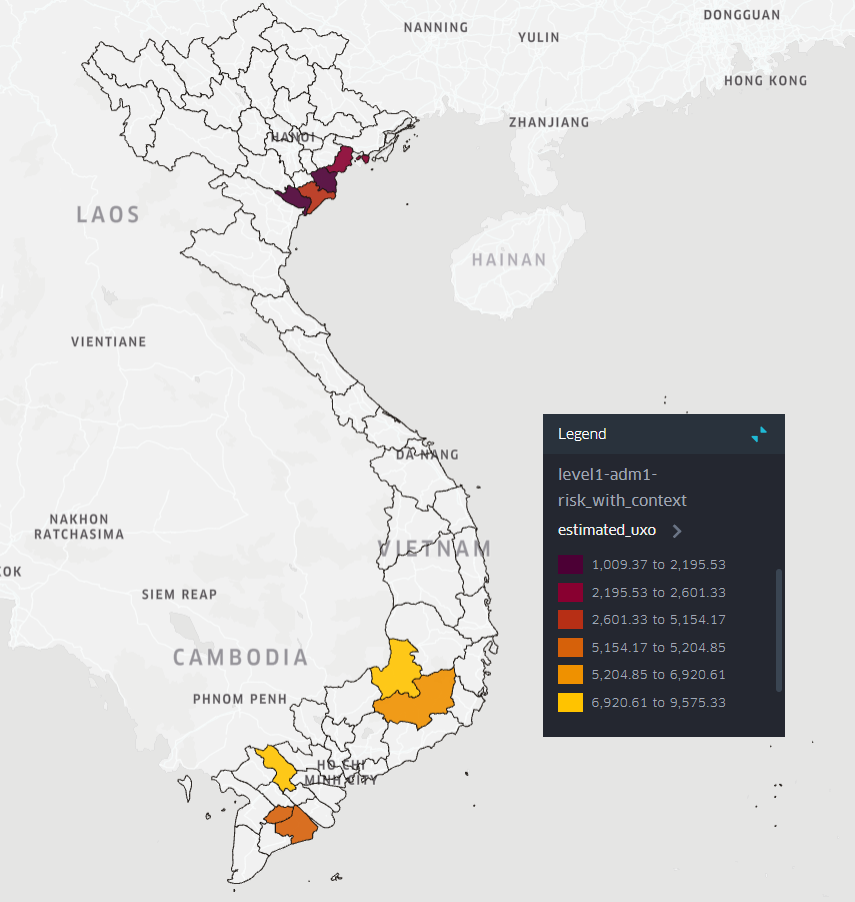
      <figcaption style="text-align: center;">Low</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      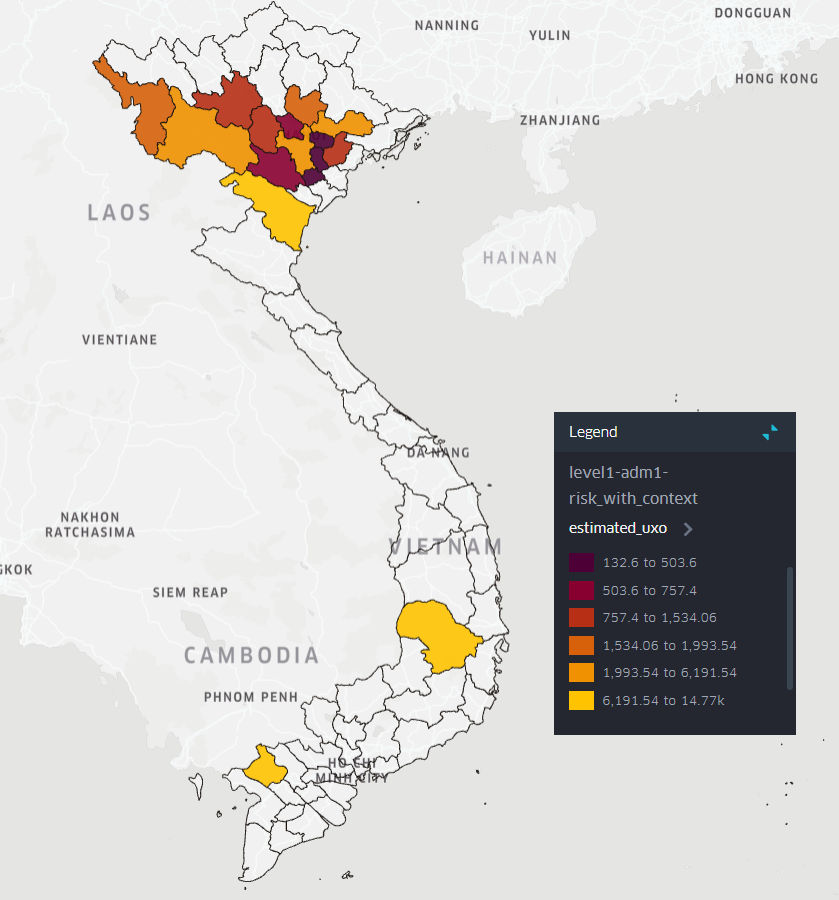
      <figcaption style="text-align: center;">Moderate</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      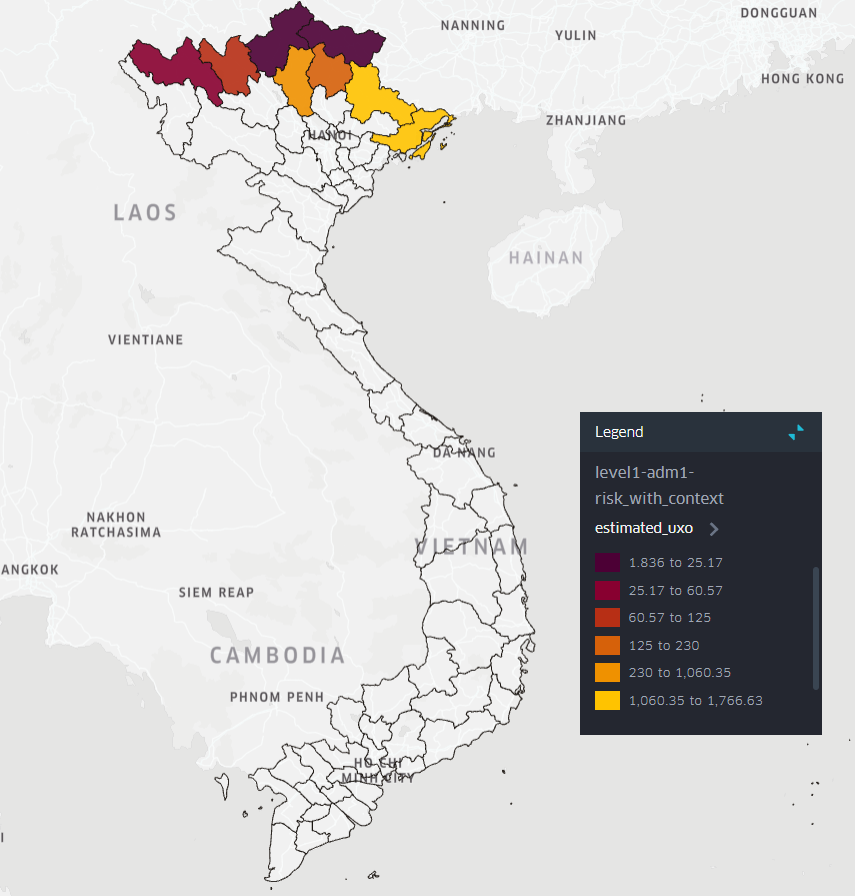
      <figcaption style="text-align: center;">Elevated</figcaption>
    </figure>
  </td>
</tr>
</table>

<table>
<tr>
    <td>
    <figure>
      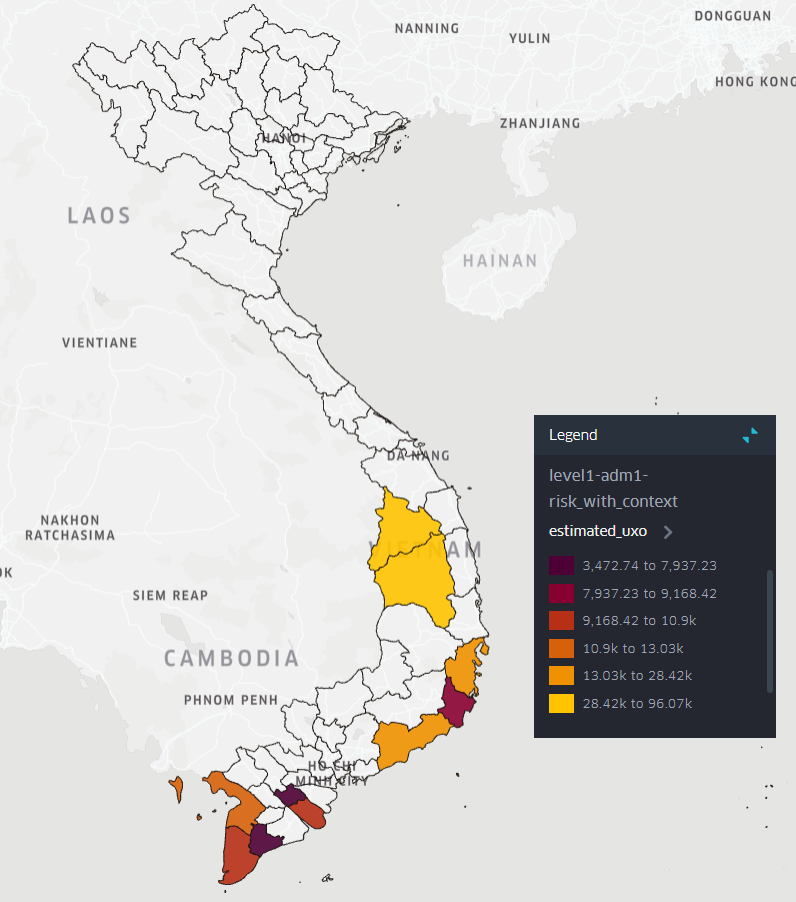
      <figcaption style="text-align: center;">High</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      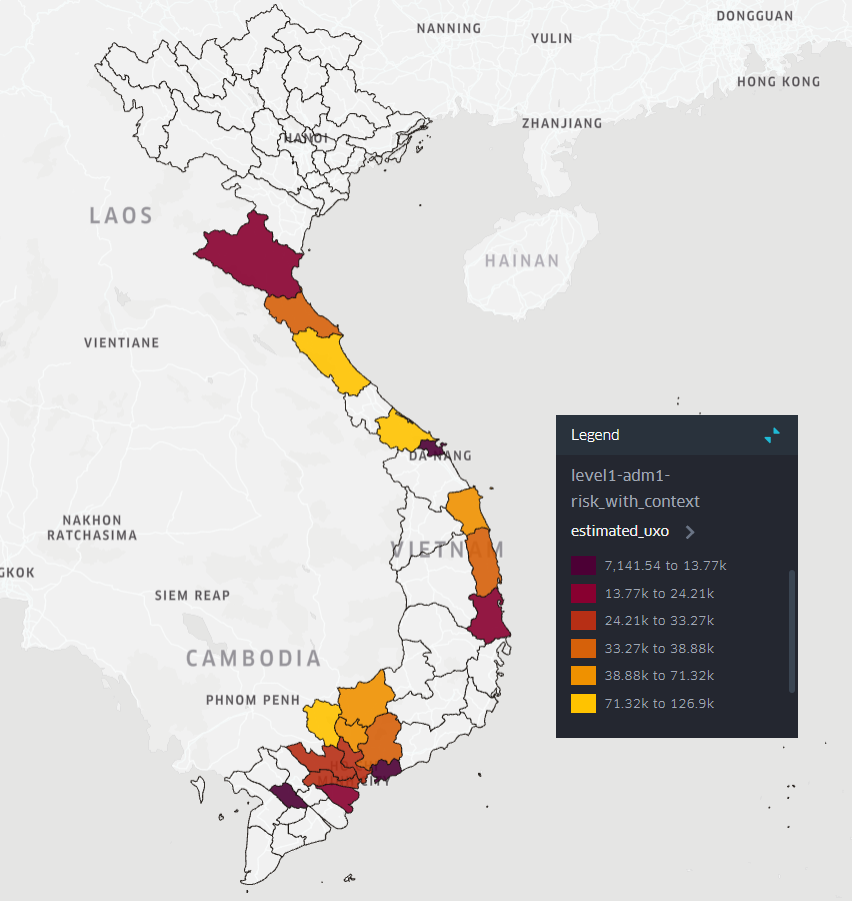
      <figcaption style="text-align: center;">Very high</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      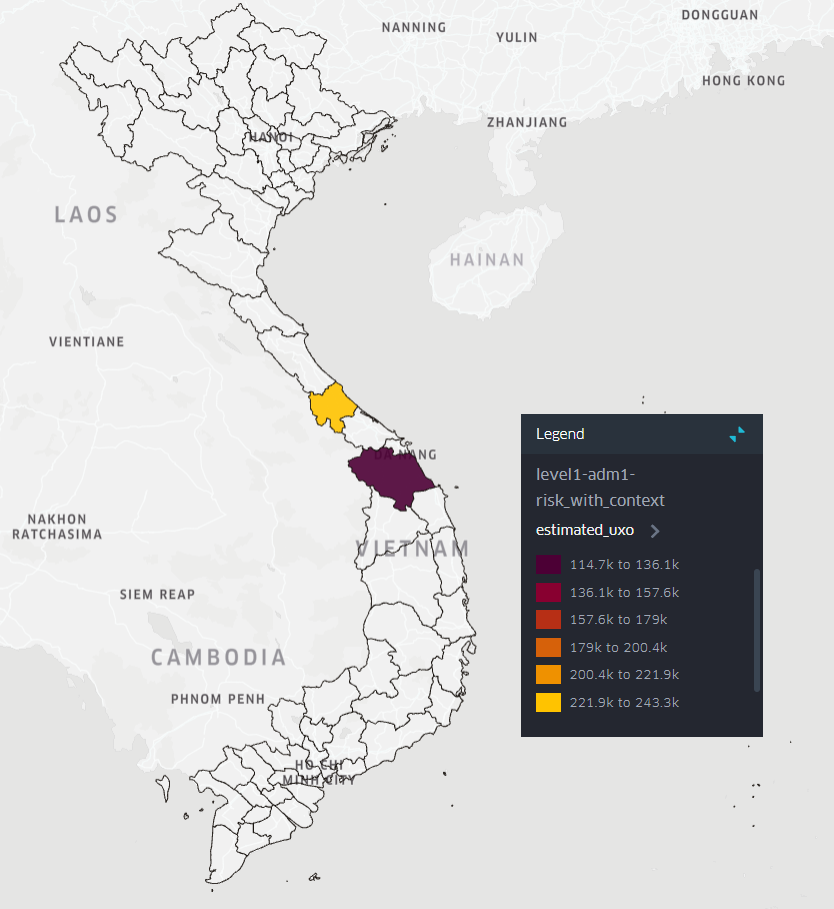
      <figcaption style="text-align: center;">Extreme</figcaption>
    </figure>
  </td>
</tr>
</table>

### Examining latest population cencus data (2023)

<table>
<tr>
    <td>
    <figure>
      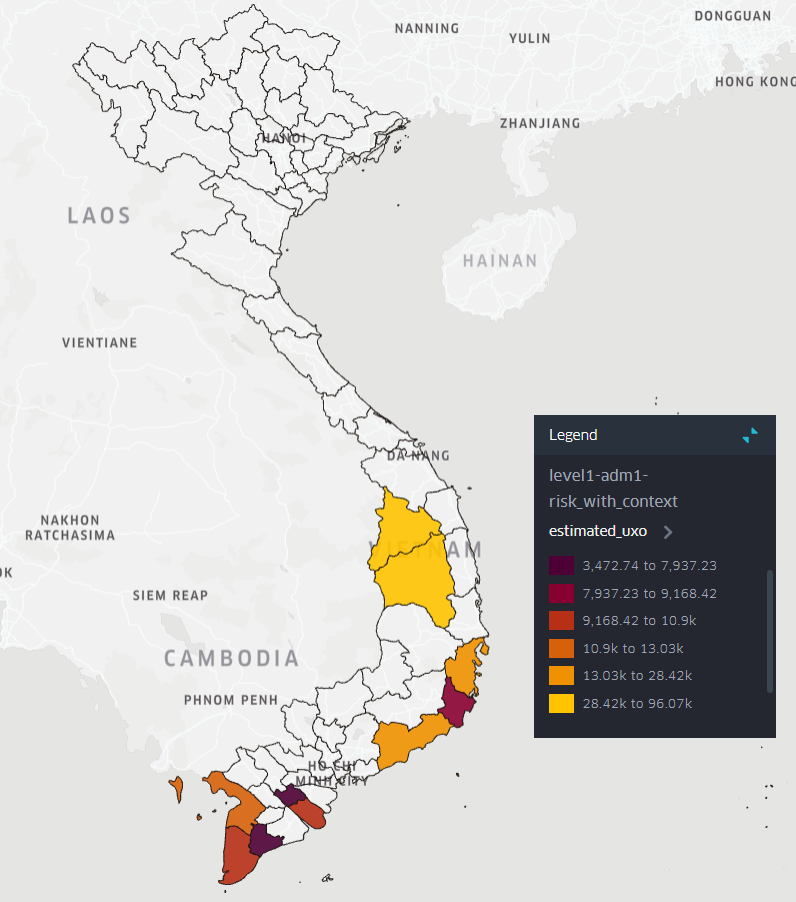
      <figcaption style="text-align: center;">High</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      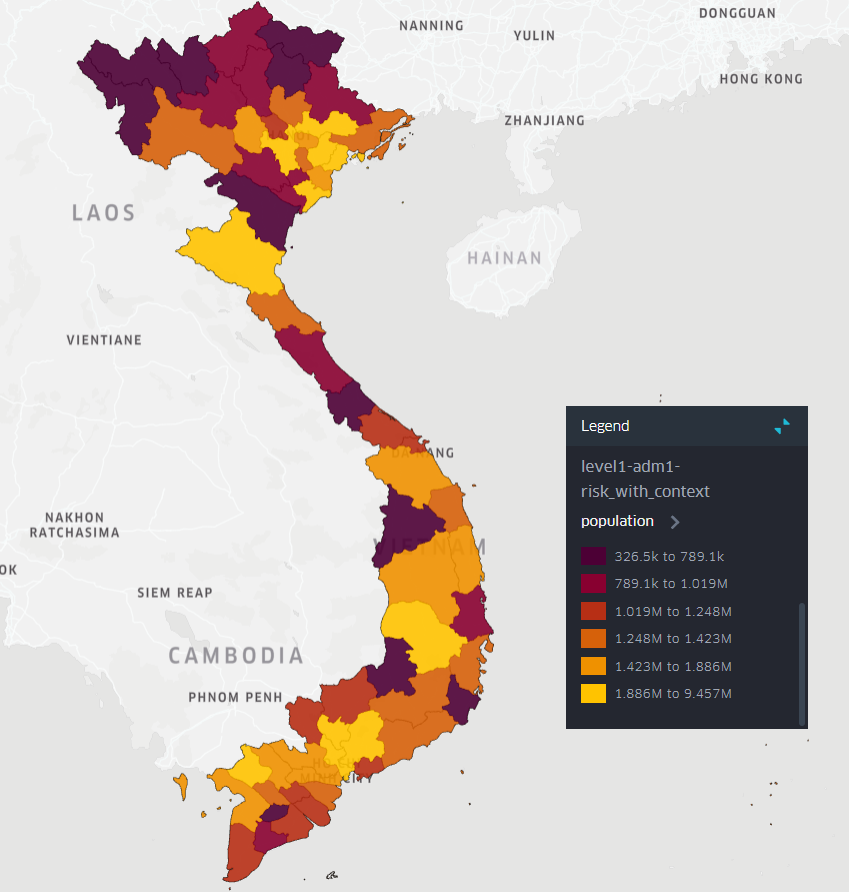
      <figcaption style="text-align: center;">Population</figcaption>
    </figure>
  </td>
</tr>
</table>

# 4. Simple cleanup area selection method
In this part I'm going to create a weighted scores which are manually tuned based on the analysis above. Then I will rank the regions within the same ADM1 Risk level then further investigate ADM2 areas.

## Level 1 Selection

In [181]:
level1.columns

Index(['ADM1_id', 'estimated_uxo', 'weighted_risk_score', 'mission_density',
       'risk_level', 'is_hotspot', 'geometry', 'city', 'population',
       'area(km2)', 'residence developed', 'residence', 'agricultural',
       'open_terrain', 'shrubland', 'forest', 'wetlands_water'],
      dtype='object')

### Normalized Metrics and Priority Score
To normalize all metrics, ensure each variable is scaled to a range between 0 and 1 (or another consistent range) using min-max normalization:

$$\text{Normalized Value} = \frac{\text{Value} - \text{Min Value}}{\text{Max Value} - \text{Min Value}}$$

The **Priority Score** is calculated as a weighted sum of normalized metrics:

$$\text{Priority Score} = w_1 \cdot \text{estimated\_uxo} + w_2 \cdot \text{population} + w_3 \cdot \text{area(km²)} + w_4 \cdot \text{is\_hotspot} + w_5 \cdot \text{residence} + w_6 \cdot \text{agricultural} + w_7 \cdot \text{open\_terrain} + w_8 \cdot \text{shrubland} + w_9 \cdot \text{forest} + w_{10} \cdot \text{wetlands\_water} + w_{11} \cdot \text{residence\_developed}$$

### Weight Constraints Table
| Metric            | Weight | Sign Constraint | Note |
|-------------------|--------|-----------------|------|
| estimated_uxo     | $w_1$   | > 0        | More urgent
| population        | $w_2$   | > 0        | More urgent
| area (km²)        | $w_3$   | < 0        | For lower budget
| is_hotspot        | $w_4$   | > 0        | More urgent
| residence         | $w_5$   | > 0        | Trend found in QTMAC 
| agricultural      | $w_6$   | > 0        | Open area trend found in QTMAC
| open_terrain      | $w_7$   | > 0        | Open area trend found in QTMAC
| shrubland         | $w_8$   | < 0        | Areas with lots of tress are harder to search
| forest            | $w_9$   | < 0        | Areas with lots of tress are harder to search
| wetlands_water    | $w_{10}$   | < 0        | Wetland harder to search
| residence_developed | $w_{11}$ | < 0        | Developed areas are already demined or are too expensive

In [103]:
from sklearn.preprocessing import MinMaxScaler

def calculate_priority(df):
    result = df.copy()
    
    cols_to_normalize = [
        'estimated_uxo', 'population', 'area(km2)', 
        'is_hotspot', 'residence', 'agricultural', 
        'open_terrain', 'shrubland', 'forest', 
        'wetlands_water', 'residence developed'
    ]
    
    scaler = MinMaxScaler()
    
    cols_present = [col for col in cols_to_normalize if col in result.columns]
    if cols_present:
        result[cols_present] = scaler.fit_transform(result[cols_present])
    
    weights = {
        'estimated_uxo': 5.0,       
        'population': 5.0,           
        'area(km2)': -2.0,          
        'is_hotspot': 3.0,          
        'residence': 2.5,           
        'agricultural': 1.5,        
        'open_terrain': 1.0,        
        'shrubland': -1.0,          
        'forest': -1.5,              
        'wetlands_water': -3.0,     
        'residence developed': -20.0
    }
    
    result['priority_score'] = sum(result[col] * weights[col] 
                                  for col in cols_present if col in weights)
    
    return result.sort_values('priority_score', ascending=False)

prioritized = calculate_priority(level1)

In [104]:
def print_grouped_6_columns(df):
    for level, group in df.groupby('risk_level'):
        print(f"Risk Level: {level}")
        
        # Prepare the data as "city: score" strings
        entries = [f"{row['city']}: {row['priority_score']:.2f}" for _, row in group.iterrows()]
        
        # Print 6 columns per row
        for i in range(0, len(entries), 6):
            row_entries = entries[i:i+6]
            print(" | ".join(f"{e:<20}" for e in row_entries))
        

print_grouped_6_columns(prioritized)
print(prioritized.groupby('risk_level')['priority_score'].mean())

Risk Level: Elevated
Đồng Tháp: 4.96      | Hậu Giang: 4.90      | Sóc Trăng: 3.62      | Đắk Nông: -1.17      | Thái Bình: -1.26     | Lâm Đồng: -1.55     
Ninh Bình: -1.64     | Nam Định: -2.97      | Hải Phòng: -9.74    
Risk Level: Extreme
Quảng Trị: 7.66      | Quảng Nam: 2.30     
Risk Level: High
Vĩnh Long: 4.97      | Kiên Giang: 3.43     | Trà Vinh: 3.32       | Kon Tum: 3.05        | Gia Lai: 2.19        | Bình Thuận: 1.78    
Khánh Hòa: 1.68      | Ninh Thuận: 1.67     | Cà Mau: 0.51         | Bạc Liêu: -0.87     
Risk Level: Low
Lai Châu: -0.88      | Lào Cai: -1.02       | Lạng Sơn: -1.10      | Hà Giang: -1.16      | Tuyên Quang: -1.28   | Bắc Kạn: -1.53      
Cao Bằng: -1.62      | Quảng Ninh: -6.03   
Risk Level: Moderate
An Giang: 2.66       | Sơn La: -0.13        | Điện Biên: -0.40     | Bắc Giang: -0.43     | Phú Thọ: -0.72       | Thanh Hóa: -0.99    
Đắk Lắk: -1.07       | Yên Bái: -1.60       | Hòa Bình: -1.85      | Vĩnh Phúc: -2.09     | Thái Nguyên: -2.27   | H

#### As said earlier, supposed that Extreme and Elevated Risk level is taken care of, we are going to clear UXO for area with ADM1 with **High** risk level
##### We will pick Vĩnh Long for example
- We will estimate the cost to clean up everything.
- And select a few district that matches our estimated parameters derived from Quang Tri mine action center data.

In [184]:
vinhlong_adm2 = level2[level2['ADM1_name'] == 'Vĩnh Long']

Between 2010 and 2020, Vietnam spent approximately \\$549 million to clear nearly 500,000 hectares (5,000 km²) of land contaminated with unexploded ordnance (UXO). This equates to an average cost of about \\$109,800 per hectare or \\$1.098 million per km².\
*Source: https://hanoitimes.vn/vietnam-spends-us549-million-on-unexploded-ordnance-settlement-in-2010-2020-315827.html*

In [191]:
print(f"Estimated cost for Vĩnh Long city UXO demining operation at ${int(cost_per_km2):,} per km²\n")

# Print header
print(f"{'District':<15} {'Risk':<10} {'Est. UXO':>10} {'Area (km²)':>12} {'Clearance Cost ($)':>20}")
print("-" * 70)

# Print each district
for _, row in vinhlong_adm2.iterrows():
    name = row['ADM2_name']
    risk = row['adm2_risk']
    uxo = row['estimated_uxo']
    area = row['area(km2)']
    cost = row['demining_cost']
    print(f"{name:<15} {risk:<10} {uxo:10.2f} {area:12.2f} {cost:20,.0f}")

# Totals
print("-" * 70)
print(f"{'Total':<15} {'':<10} {'':>10} {total_area:12.2f} {total_cost:20,.0f}")


Estimated cost for Vĩnh Long city UXO demining operation at $109,800 per km²

District        Risk         Est. UXO   Area (km²)   Clearance Cost ($)
----------------------------------------------------------------------
Mang Thit       High           225.08       170.00           18,666,000
Vung Liem       High          1016.47       300.00           32,940,000
Tam Binh        Very High     2509.78       290.00           31,842,000
Vinh Long       High           161.17        40.00            4,392,000
Binh Tan        High           727.78       180.00           19,764,000
Long Ho         High           528.21       190.00           20,862,000
Tra On          Very High     2013.04       270.00           29,646,000
Binh Minh       High           145.52        80.00            8,784,000
----------------------------------------------------------------------
Total                                      1520.00          166,896,000


Suppose that the government only choose Districts with the **highest** risk in a Vinh Long province we would be able to know the areas we need to clear.

<table>
<tr>
  <td>
    <figure>
      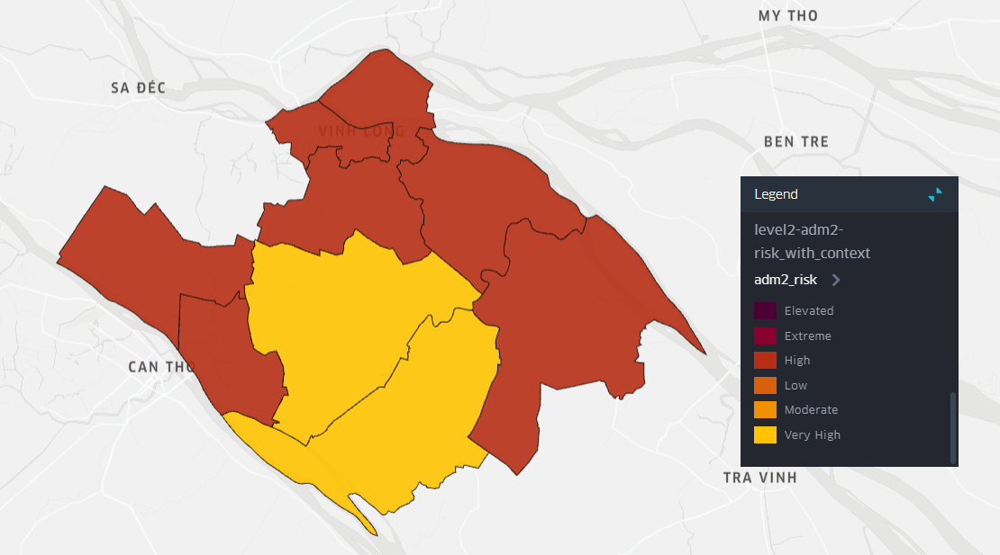
      <figcaption style="text-align: center;">Risk levels inside Vinh Long province</figcaption>
    </figure>
  </td>
  <td>
    <figure>
      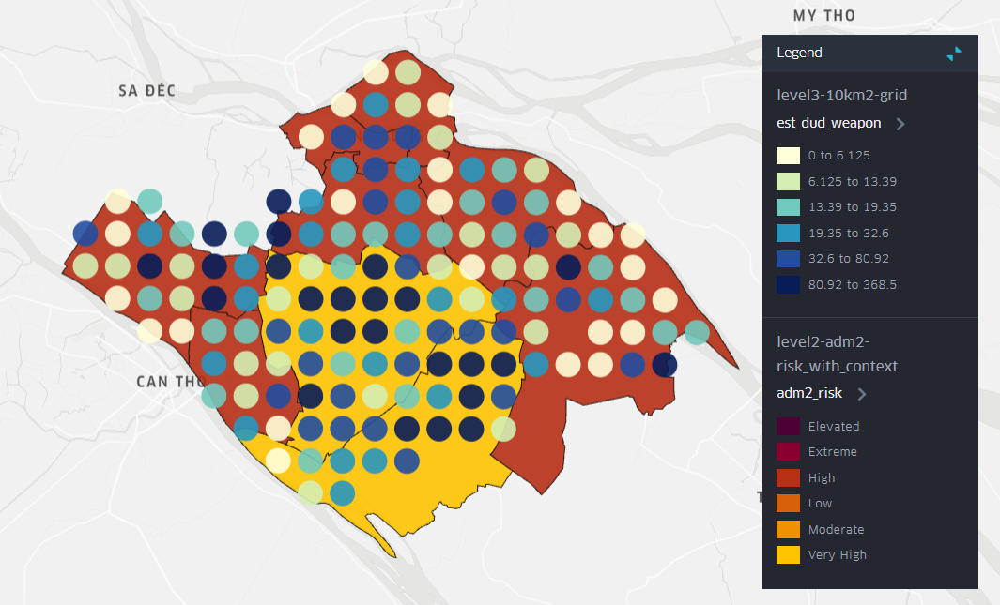
      <figcaption style="text-align: center;">Risk levels of districts in Vinh Long overlaid with grid risk level</figcaption>
    </figure>
  </td>
    <td>
    <figure>
      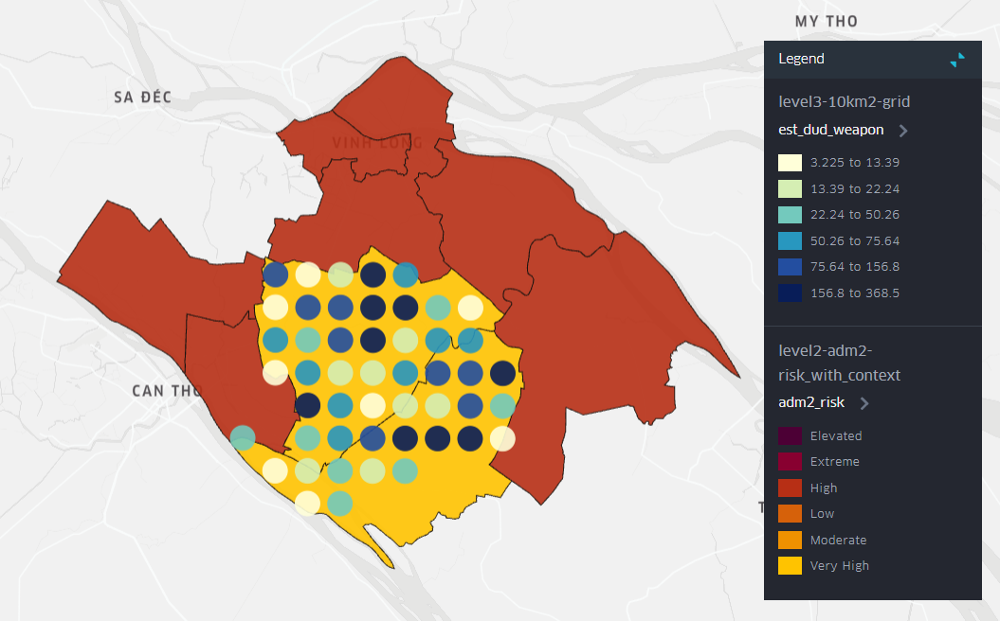
      <figcaption style="text-align: center;">Risk levels of districts in Vinh Long overlaid with Tra On and Tam Binh 10km2 risk levels </figcaption>
    </figure>
  </td>
</tr>
</table>

In [106]:
vinh_long_clearance_grid = level3[level3['ADM2_name'].isin(['Tra On', 'Tam Binh'])]
print(f"Total 10km2 grids to clear in Tra On and Tam Binh is {len(vinh_long_clearance_grid)}")
vinh_long_clearance_grid.head(5)

Total 10km2 grids to clear in Tra On and Tam Binh is 56


,grid_id,est_dud_weapon,mission_count,weapons_delivered,ADM1_name,ADM1_id,ADM2_name,ADM2_id,grid_center_lon,grid_center_lat,risk_score,risk_level,residence developed,residence,agricultural,open_terrain,shrubland,forest,wetlands_water
7658,187_349,22.815,29,1034,Vĩnh Long,63759600B66868150968055,Tra On,81297802B90328181900706,105.847873,9.997144,0.005085,Very High,0.0,0.006410,0.628205,0.0,0.0,0.0,0.365385
7823,188_348,3.225,6,31,Vĩnh Long,63759600B66868150968055,Tra On,81297802B90328181900706,105.876647,9.968471,0.000397,Moderate,0.0,0.006944,0.784722,0.0,0.0,0.0,0.208333
7826,188_351,11.222,26,254,Vĩnh Long,63759600B66868150968055,Tam Binh,81297802B334334492772,105.876877,10.054265,0.002057,High,0.0,0.013889,0.986111,0.0,0.0,0.0,0.000000
7827,188_352,55.231,112,818,Vĩnh Long,63759600B66868150968055,Tam Binh,81297802B334334492772,105.876954,10.082863,0.008436,Very High,0.0,0.019231,0.980769,0.0,0.0,0.0,0.000000
7828,188_353,9.372,25,754,Vĩnh Long,63759600B66868150968055,Tam Binh,81297802B334334492772,105.877032,10.111461,0.003475,High,0.0,0.013889,0.972222,0.0,0.0,0.0,0.013889


#### Finding news related to UXO from data scraped from internet

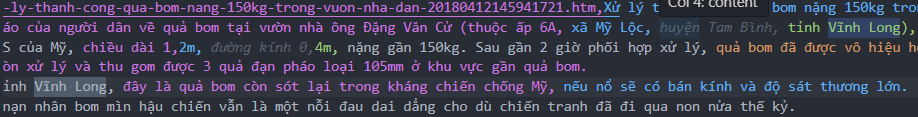

In my limited dataset I have found 2 occurance, future direction, comparing distribution of locations mentioned in news paper and locations marked with high risk

In [2]:
qtmac = pd.read_csv('data/qtmac_data.csv')

In [132]:
import re
import unicodedata

# List of Vietnamese cities
cities = [
    'Cao Bằng', 'Tiền Giang', 'Đồng Nai', 'Bình Phước', 'Gia Lai',
    'Kiên Giang', 'Ninh Thuận', 'Cần Thơ', 'Quảng Trị', 'Bà Rịa–Vũng Tàu',
    'Long An', 'Đắk Nông', 'Lai Châu', 'Tây Ninh', 'Lâm Đồng', 'Phú Yên',
    'Bắc Kạn', 'Thanh Hóa', 'Bình Thuận', 'Tuyên Quang', 'Ninh Bình',
    'Vĩnh Phúc', 'Trà Vinh', 'Bắc Giang', 'Hà Nam', 'Hưng Yên', 'Sơn La',
    'Bắc Ninh', 'Nam Định', 'Lào Cai', 'Phú Thọ', 'An Giang',
    'Bình Dương', 'Quảng Ninh', 'Bạc Liêu', 'Hà Tĩnh', 'Yên Bái',
    'Quảng Ngãi', 'Hải Phòng', 'Thái Bình', 'Sóc Trăng', 'Lạng Sơn',
    'Quảng Bình', 'Kon Tum', 'Hải Dương', 'Vĩnh Long', 'Thái Nguyên',
    'Bến Tre', 'Điện Biên', 'Thừa Thiên Huế', 'Quảng Nam', 'Khánh Hòa',
    'Hà Giang', 'Ho Chi Minh', 'Cà Mau', 'Đồng Tháp', 'Nghệ An',
    'Đà Nẵng', 'Hậu Giang', 'Hòa Bình', 'Đắk Lắk', 'Hà Nội', 'Bình Định'
]

# Normalization function
def normalize(text):
    text = text.lower()
    text = unicodedata.normalize('NFD', text)
    text = ''.join(c for c in text if unicodedata.category(c) != 'Mn')  # remove accents
    text = re.sub(r'[^\w\s]', ' ', text)  # remove punctuation
    text = re.sub(r'\s+', ' ', text).strip()  # clean up extra spaces
    return text

# Read raw text from CSV
with open('news_data_with_content.csv', 'r', encoding='utf-8') as file:
    raw_text = file.read()

# Normalize the entire text
normalized_text = normalize(raw_text)

# Normalize city names and count occurrences
city_counts = {}
for city in cities:
    norm_city = normalize(city)
    count = len(re.findall(rf'\b{re.escape(norm_city)}\b', normalized_text))
    city_counts[city] = count

# Sort by frequency
sorted_counts = dict(sorted(city_counts.items(), key=lambda x: x[1], reverse=True))

# Print top 10
for city, count in list(sorted_counts.items()):
    print(f"{city}: {count}")

Quảng Trị: 963
Hòa Bình: 334
Quảng Bình: 205
Đà Nẵng: 202
Hà Nội: 167
Thừa Thiên Huế: 134
Quảng Nam: 112
Bình Định: 96
Hà Tĩnh: 80
Quảng Ngãi: 76
Trà Vinh: 63
Bạc Liêu: 59
Hải Phòng: 54
Kon Tum: 50
Đồng Nai: 48
Nghệ An: 47
Cà Mau: 45
Bình Phước: 40
Thái Bình: 37
Hà Giang: 35
Ho Chi Minh: 35
Điện Biên: 32
Bình Dương: 30
Quảng Ninh: 29
Thanh Hóa: 24
Ninh Bình: 23
Phú Yên: 21
Hà Nam: 21
Bình Thuận: 19
Gia Lai: 16
Lạng Sơn: 15
Bà Rịa–Vũng Tàu: 14
Tây Ninh: 14
Đồng Tháp: 12
Cần Thơ: 11
An Giang: 11
Cao Bằng: 9
Vĩnh Phúc: 9
Sơn La: 9
Bắc Ninh: 9
Khánh Hòa: 9
Kiên Giang: 8
Vĩnh Long: 7
Tiền Giang: 6
Lai Châu: 6
Lâm Đồng: 6
Long An: 5
Nam Định: 5
Lào Cai: 5
Đắk Lắk: 5
Hưng Yên: 4
Yên Bái: 4
Hải Dương: 4
Bến Tre: 4
Phú Thọ: 3
Sóc Trăng: 3
Tuyên Quang: 2
Đắk Nông: 1
Thái Nguyên: 1
Hậu Giang: 1
Ninh Thuận: 0
Bắc Kạn: 0
Bắc Giang: 0
     city_original city_normalized  count
8        Quảng Trị       quang tri    963
59        Hòa Bình        hoa binh    334
42      Quảng Bình      quang binh    205

In [149]:
data = {
    "city_original": [],
    "count": []
}

for city in cities:
    norm_city = normalize(city)
    count = city_counts[city]
    data["city_original"].append(city)
    data["count"].append(count)

df = pd.DataFrame(data)

# Sort by count descending
df = df.sort_values(by="count", ascending=False)


df['count_normalized'] = (df['count'] - df['count'].min()) / (df['count'].max() - df['count'].min())
print(df.  head(10))  # Show top 10 rows

     city_original  count  count_normalized
8        Quảng Trị    963          1.000000
59        Hòa Bình    334          0.346833
42      Quảng Bình    205          0.212876
57         Đà Nẵng    202          0.209761
61          Hà Nội    167          0.173416
49  Thừa Thiên Huế    134          0.139148
50       Quảng Nam    112          0.116303
62       Bình Định     96          0.099688
35         Hà Tĩnh     80          0.083074
37      Quảng Ngãi     76          0.078920


In [150]:
merged_df = df.merge(prioritized[['city', 'priority_score']].rename(columns={'city' : 'city_original'}), 'left', 'city_original')

In [151]:
merged_df['norm_score'] = (merged_df['priority_score'] - merged_df['priority_score'].min()) / (merged_df['priority_score'].max() - merged_df['priority_score'].min())

In [164]:
merged_df

,city_original,count,count_normalized,priority_score,norm_score
0,Quảng Trị,963,1.000000,7.657116,1.000000
1,Hòa Bình,334,0.346833,-1.847832,0.620681
2,Quảng Bình,205,0.212876,3.975922,0.853093
3,Đà Nẵng,202,0.209761,-17.400792,0.000000
4,Hà Nội,167,0.173416,-11.045648,0.253618
...,...,...,...,...,...
58,Hậu Giang,1,0.001038,4.895307,0.889783
59,Thái Nguyên,1,0.001038,-2.267784,0.603921
60,Ninh Thuận,0,0.000000,1.666411,0.760926
61,Bắc Giang,0,0.000000,-0.432953,0.677145


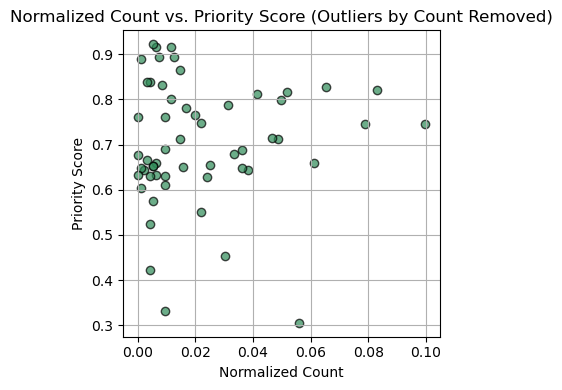

,count,count_normalized,priority_score,norm_score,count_capped,count_normalized_capped
count,1.000000,1.000000,0.045876,0.045876,1.000000,1.000000
count_normalized,1.000000,1.000000,0.045876,0.045876,1.000000,1.000000
priority_score,0.045876,0.045876,1.000000,1.000000,0.045876,0.045876
norm_score,0.045876,0.045876,1.000000,1.000000,0.045876,0.045876
count_capped,1.000000,1.000000,0.045876,0.045876,1.000000,1.000000
count_normalized_capped,1.000000,1.000000,0.045876,0.045876,1.000000,1.000000


In [175]:
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Copy the original DataFrame
df_cleaned = merged_df

# Step 2: Remove outliers based on 'count' using IQR method
Q1 = df_cleaned['count'].quantile(0.25)
Q3 = df_cleaned['count'].quantile(0.75)
IQR = Q3 - Q1

# Filter out count outliers
df_cleaned = df_cleaned[
    (df_cleaned['count'] >= Q1 - 1.5 * IQR) &
    (df_cleaned['count'] <= Q3 + 1.5 * IQR)
]

# Step 3: Scatter plot
plt.figure(figsize=(4, 4))
plt.scatter(
    df_cleaned['count_normalized'],
    df_cleaned['norm_score'],
    alpha=0.7,
    c='seagreen',
    edgecolors='k'
)
plt.title('Normalized Count vs. Priority Score (Outliers by Count Removed)')
plt.xlabel('Normalized Count')
plt.ylabel('Priority Score')
plt.grid(True)
plt.tight_layout()
plt.show()

df_cleaned.corr(numeric_only=True)

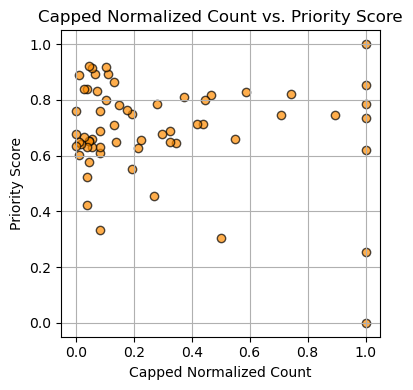

In [172]:
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Copy the original DataFrame
df_capped = merged_df

# Step 2: Compute IQR bounds
Q1 = df_capped['count'].quantile(0.25)
Q3 = df_capped['count'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Step 3: Cap outliers in 'count'
df_capped['count_capped'] = df_capped['count'].clip(lower=lower_bound, upper=upper_bound)

# Step 4: Recalculate normalized count (optional)
df_capped['count_normalized_capped'] = df_capped['count_capped'] / df_capped['count_capped'].max()

# Step 5: Scatter plot
plt.figure(figsize=(4, 4))
plt.scatter(
    df_capped['count_normalized_capped'],
    df_capped['norm_score'],
    alpha=0.7,
    c='darkorange',
    edgecolors='k'
)
plt.title('Capped Normalized Count vs. Priority Score')
plt.xlabel('Capped Normalized Count')
plt.ylabel('Priority Score')
plt.grid(True)
plt.tight_layout()
plt.show()
